# Federated Learning

## Importing required modules

In [1]:
import torch
import torch.nn as nn
from torch.autograd import Variable

from torchsummary import summary
import math
from collections import OrderedDict

from tqdm.auto import tqdm
import torchvision
import torchvision.transforms as transforms
from torch.utils.data import Dataset, DataLoader
from sklearn.metrics import confusion_matrix
import time
import torch.optim as optim
import torch.nn as nn
import torch.nn.functional as F
from torch.autograd import Variable

import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
import itertools
import copy
from sklearn.metrics import f1_score


seed = 2045
def manual_seed(seed):
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    from torch.backends import cudnn
    cudnn.deterministic = True #type: ignore
    cudnn.benchmark = False # type: ignore

if (torch.cuda.is_available()):
    DEVICE = 'cuda'
else:
    DEVICE = 'cpu'
 
print(f'Device is set to {DEVICE}')

Device is set to cuda


## Loading the dataset and pre-processing

In [2]:
train_set = torchvision.datasets.FashionMNIST(root="./", download=True, 
                                              train=True,
                                              transform=transforms.Compose([transforms.ToTensor(),transforms.Normalize(0.5,0.5)]))

val_set = torchvision.datasets.FashionMNIST(root="./", download=True, 
                                              train=False,
                                              transform=transforms.Compose([transforms.ToTensor(), transforms.Normalize(0.5,0.5)]))
print(f"Size of the training set: {len(train_set)}")
print(f"Size of the test set: {len(val_set)}")

  0%|          | 0/26421880 [00:00<?, ?it/s]

Extracting ./FashionMNIST/raw/train-images-idx3-ubyte.gz to ./FashionMNIST/raw



  0%|          | 0/29515 [00:00<?, ?it/s]

Extracting ./FashionMNIST/raw/train-labels-idx1-ubyte.gz to ./FashionMNIST/raw



  0%|          | 0/4422102 [00:00<?, ?it/s]

Extracting ./FashionMNIST/raw/t10k-images-idx3-ubyte.gz to ./FashionMNIST/raw



  0%|          | 0/5148 [00:00<?, ?it/s]

Extracting ./FashionMNIST/raw/t10k-labels-idx1-ubyte.gz to ./FashionMNIST/raw

Size of the training set: 60000
Size of the test set: 10000


In [3]:
data_loader = torch.utils.data.DataLoader(train_set, batch_size=128, shuffle=True)
images, labels = next(iter(data_loader))
print(f"Image batch tensor dimensions: {images.shape}")

Image batch tensor dimensions: torch.Size([128, 1, 28, 28])


In [4]:
classes = {0: "T-shirt/top", 1: "Trouser", 2: "Pullover", 3: "Dress", 4: "Coat", 5: "Sandal", 6: "Shirt", 7: "Sneaker", 8: "Bag", 9: "Ankle boot"}
class_names = ["T-shirt/top", "Trouser", "Pullover", "Dress", "Coat", "Sandal", "Shirt", "Sneaker", "Bag", "Ankle boot"]


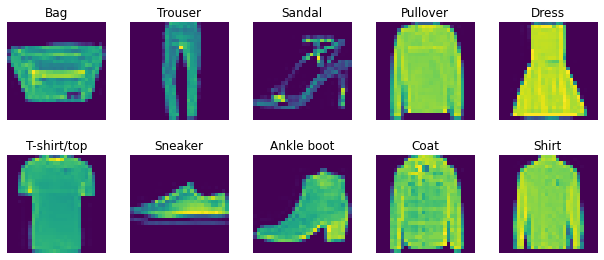

In [5]:
def imshow(img_array, labels, classes):
    figure, axs = plt.subplots(2, 5)
    count = 0
    for i in range(2):
      for j in range(5):
        imgTmp = torch.transpose(img_array[count],0,2)
        axs[i][j].imshow(torch.transpose(imgTmp, 0, 1).reshape((28,28)))
        axs[i][j].set_title(classes[int(labels[count])])
        axs[i][j].axis('off')
        count += 1
    plt.subplots_adjust(left=0.125,
                    bottom=0.1, 
                    right=1.5, 
                    top=0.9, 
                    wspace=0.2, 
                    hspace=0.35)
    plt.show()

for i, data in enumerate(data_loader):
    images, labels = data[0].to("cpu"), data[1].to("cpu")
    break
distinct_labels = []
distinct_images = []
distinct_classes = []
for i in range(len(labels)):
    if int(labels[i]) not in distinct_classes:
        distinct_labels.append(int(labels[i]))
        distinct_images.append(images[i])
        distinct_classes.append(int(labels[i]))
    if len(distinct_classes) == 10:
        break
imshow(distinct_images, distinct_labels, classes)

## Model

In [6]:
class CNN(nn.Module):
    def __init__(self):
        super(CNN, self).__init__()
        input_shape = (1, 28, 28)
        # CNN
        self.conv1 = nn.Conv2d(in_channels=1, out_channels=32, kernel_size=5,padding=1)
        self.maxPool1 = nn.MaxPool2d(kernel_size=2,padding=1)

        self.conv2 = nn.Conv2d(in_channels=32, out_channels=64, kernel_size=5,padding=1)
        self.act2 = nn.ReLU()
        self.maxPool2 = nn.MaxPool2d(kernel_size=2,padding=1)
        self.flatten = nn.Flatten()
        self.dense1 = nn.Linear(64*7*7, 512)
        self.dense2 = nn.Linear(512, 10)
        
        
        self.relu = nn.ReLU()
        self.softm = nn.Softmax(dim=1)


    def forward(self, x):
        # CNN forward
        x = self.conv1(x)
        x = self.relu(x)
        x = self.maxPool1(x)

        x = self.conv2(x)
        x = self.relu(x)
        x = self.maxPool2(x)

        # Flatten
        x = self.flatten(x)
        # Dense and softmax forward
        x = self.dense1(x)
        #x = self.relu(x)
        x = self.dense2(x)
        x = self.softm(x)

        return x

# Utility Functions

In [7]:
def fit(model, train_loader, optimizer, criterion):
    model.train()
    train_len = len(train_loader)
    batch_size = train_loader.batch_size
    n_batches = math.ceil(train_len/batch_size)
    #print('Batch Size:', batch_size,'Number of Batches:', n_batches)
    model.train()
    train_running_loss = 0.0
    train_running_correct = 0
    counter = 0
    total = 0
    #prog_bar = tqdm(enumerate(train_loader), total=int(train_len/batch_size))
    for i, data in enumerate(train_loader):
        counter += 1
        data, target = data[0].to(DEVICE), data[1].to(DEVICE)
        total += target.size(0)
        optimizer.zero_grad()
        outputs = model(data)
        loss = criterion(outputs, target)
        train_running_loss += loss.item()
        _, preds = torch.max(outputs.data, 1)
        train_running_correct += (preds == target).sum().item()
        loss.backward()
        optimizer.step()
        
    train_loss = train_running_loss / counter
    train_accuracy = 100. * train_running_correct / total
    return train_loss, train_accuracy

In [8]:
def train(hparams, train_loader):
    manual_seed(2045)
    model = CNN()
    model.to(DEVICE)
    criterion = nn.CrossEntropyLoss()
    optimizer = optim.SGD(model.parameters(), lr = 0.05, momentum=0.9)
    train_loss = []
    train_accuracy = []
    start = time.time()
    for epoch in range(hparams['epochs']):
        print(f"Epoch {epoch+1} of {hparams['epochs']}")
        train_epoch_loss, train_epoch_accuracy = fit(
            model, train_loader, optimizer, criterion
        )

        train_loss.append(train_epoch_loss)
        train_accuracy.append(train_epoch_accuracy)

                
        print(f"Train Loss: {train_epoch_loss:.4f}, Train Acc: {train_epoch_accuracy:.2f}")

    end = time.time()

    print(f"Training time: {(end-start)/60:.3f} minutes")
    return model, train_loss, train_accuracy

In [9]:
## Adopted from Stack Overflow

def plot_confusion_matrix(cm, target_names, title='Confusion matrix', cmap=None, normalize=True):
    """
    given a sklearn confusion matrix (cm), make a nice plot

    Arguments
    ---------
    cm:           confusion matrix from sklearn.metrics.confusion_matrix

    target_names: given classification classes such as [0, 1, 2]
                  the class names, for example: ['high', 'medium', 'low']

    title:        the text to display at the top of the matrix

    cmap:         the gradient of the values displayed from matplotlib.pyplot.cm
                  see http://matplotlib.org/examples/color/colormaps_reference.html
                  plt.get_cmap('jet') or plt.cm.Blues

    normalize:    If False, plot the raw numbers
                  If True, plot the proportions
    """

    accuracy = np.trace(cm) / float(np.sum(cm))
    misclass = 1 - accuracy
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
    if cmap is None:
        cmap = plt.get_cmap('Blues')

    plt.figure(figsize=(8, 6))
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()

    if target_names is not None:
        tick_marks = np.arange(len(target_names))
        plt.xticks(tick_marks, target_names, rotation=45)
        plt.yticks(tick_marks, target_names)




    thresh = cm.max() / 1.5 if normalize else cm.max() / 2
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        if normalize:
            plt.text(j, i, "{:0.2f}".format(cm[i, j]),
                     horizontalalignment="center",
                     color="white" if cm[i, j] > thresh else "black")
        else:
            plt.text(j, i, "{:,}".format(cm[i, j]),
                     horizontalalignment="center",
                     color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label\naccuracy={:0.2f}; misclass={:0.2f}'.format(accuracy, misclass))
    plt.show()

In [10]:
def detailed_analysis(model, n_classes, class_names, train_loader, test_loader, train_accuracy, train_loss):
    model.eval()

    ### Train
    loader = train_loader
    correct = 0.
    total = 0.
    class_corrects = [0.] * n_classes
    class_totals = [0.] * n_classes
    class_accs_train = [0.] * n_classes
    y_true = []
    y_pred = []
    with torch.no_grad():
      for images, labels in loader:
        outputs = model(images.to(DEVICE))
        _, predicted = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (predicted.to('cpu') == labels).sum().item()
        Bool = (predicted.to('cpu') == labels)
        y_pred.extend(list(predicted.to('cpu').numpy()))
        y_true.extend(list(labels.numpy()))
        for i in range(len(images)):
            class_totals[labels[i]] += 1
            if Bool[i] == True:
              class_corrects[labels[i]] += 1
    for i in range(n_classes):
      class_accs_train[i] = class_corrects[i]/class_totals[i]

    cm_train = confusion_matrix(y_true, y_pred)
    y_true_train = copy.deepcopy(y_true)
    y_pred_train = copy.deepcopy(y_pred)
    

    ### Test
    loader = test_loader
    correct = 0.
    total = 0.
    class_corrects = [0.] * n_classes
    class_totals = [0.] * n_classes
    class_accs_test = [0.] * n_classes
    y_true = []
    y_pred = []
    with torch.no_grad():
      for images, labels in loader:
        outputs = model(images.to(DEVICE))
        _, predicted = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (predicted.to('cpu') == labels).sum().item()
        Bool = (predicted.to('cpu') == labels)
        y_pred.extend(list(predicted.to('cpu').numpy()))
        y_true.extend(list(labels.numpy()))
        for i in range(len(images)):
            class_totals[labels[i]] += 1
            if Bool[i] == True:
              class_corrects[labels[i]] += 1
    for i in range(n_classes):
      class_accs_test[i] = class_corrects[i]/class_totals[i]
    cm_test = confusion_matrix(y_true, y_pred)
    y_true_test = copy.deepcopy(y_true)
    y_pred_test = copy.deepcopy(y_pred)

    fig, axs = plt.subplots(3, figsize=(30,20))
    axs[0].plot(list(range(1,len(train_loss)+1)), train_loss, label='Train Loss')
    axs[0].set_title('Loss per Epoch')
    axs[0].set_ylabel('Epoch')
    axs[0].set_xlabel('Loss')
    axs[0].legend()

    axs[1].plot(list(range(1,len(train_accuracy)+1)), train_accuracy, label='Train Acc')
    axs[1].set_title('Acc per Epoch')
    axs[1].set_ylabel('Epoch')
    axs[1].set_xlabel('Acc')
    axs[1].legend()

    x = np.arange(len(class_names))
    width = 0.2
    trains = axs[2].bar(x, class_accs_train, width, label='Train')
    tests = axs[2].bar(x + width, class_accs_test, width, label = 'Test')
    axs[2].set_ylabel('Accuracy')
    axs[2].set_title('Accuracy of Each Class')
    axs[2].set_xticks(x+width/2)
    axs[2].set_xticklabels(class_names)
    axs[2].legend()
    plt.show()

    return cm_train, cm_test, y_true_train, y_pred_train, y_true_test, y_pred_test

## Centralized Traininig

In [11]:
# Hyperparameters dict
hparams = {'batch_size': 128, 'epochs': 10}
train_loader = torch.utils.data.DataLoader(train_set, batch_size=hparams["batch_size"], shuffle=True)
test_loader = torch.utils.data.DataLoader(val_set, batch_size=hparams["batch_size"], shuffle=True)
model = CNN()
model.to(DEVICE)
summary(model, (1, 28, 28), batch_size=hparams['batch_size'])

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1          [128, 32, 26, 26]             832
              ReLU-2          [128, 32, 26, 26]               0
         MaxPool2d-3          [128, 32, 14, 14]               0
            Conv2d-4          [128, 64, 12, 12]          51,264
              ReLU-5          [128, 64, 12, 12]               0
         MaxPool2d-6            [128, 64, 7, 7]               0
           Flatten-7                [128, 3136]               0
            Linear-8                 [128, 512]       1,606,144
            Linear-9                  [128, 10]           5,130
          Softmax-10                  [128, 10]               0
Total params: 1,663,370
Trainable params: 1,663,370
Non-trainable params: 0
----------------------------------------------------------------
Input size (MB): 0.38
Forward/backward pass size (MB): 73.02
Params size (MB): 6.35
Estima

In [ ]:
model, train_loss, train_accuracy = train(hparams, train_loader)


Epoch 1 of 10
Train Loss: 1.7355, Train Acc: 73.18
Epoch 2 of 10
Train Loss: 1.6183, Train Acc: 84.43
Epoch 3 of 10
Train Loss: 1.5958, Train Acc: 86.62
Epoch 4 of 10
Train Loss: 1.5825, Train Acc: 87.92
Epoch 5 of 10
Train Loss: 1.5737, Train Acc: 88.75
Epoch 6 of 10
Train Loss: 1.5674, Train Acc: 89.42
Epoch 7 of 10
Train Loss: 1.5633, Train Acc: 89.78
Epoch 8 of 10
Train Loss: 1.5594, Train Acc: 90.23
Epoch 9 of 10
Train Loss: 1.5537, Train Acc: 90.72
Epoch 10 of 10
Train Loss: 1.5520, Train Acc: 90.93
Training time: 1.949 minutes


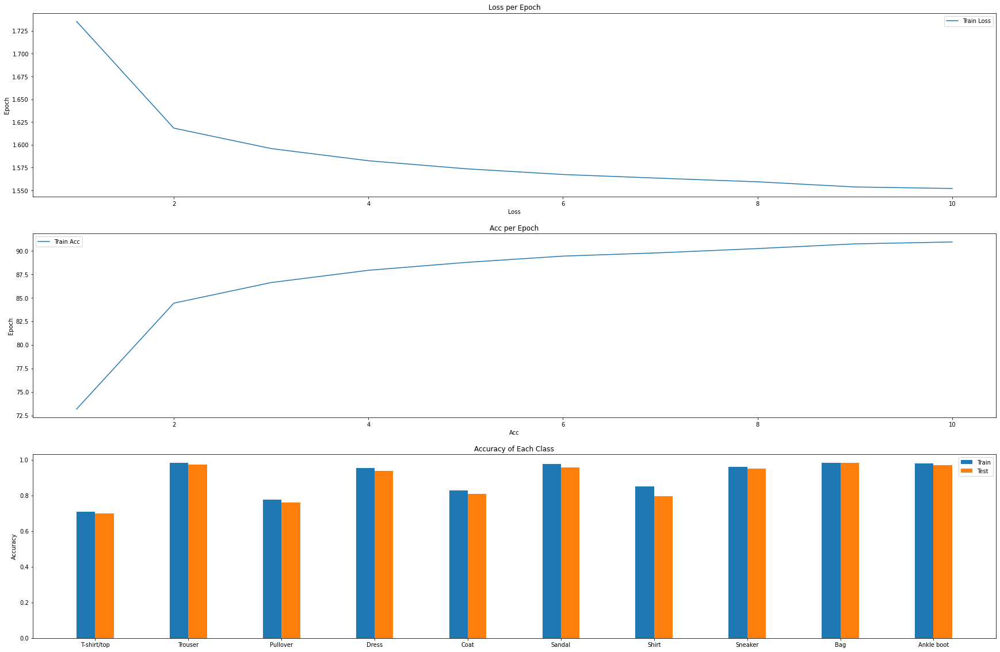

In [ ]:
cm_train, cm_test, y_true_train, y_pred_train, y_true_test, y_pred_test = detailed_analysis(model, 10, class_names,\
                                                                      train_loader, test_loader, train_accuracy, train_loss)

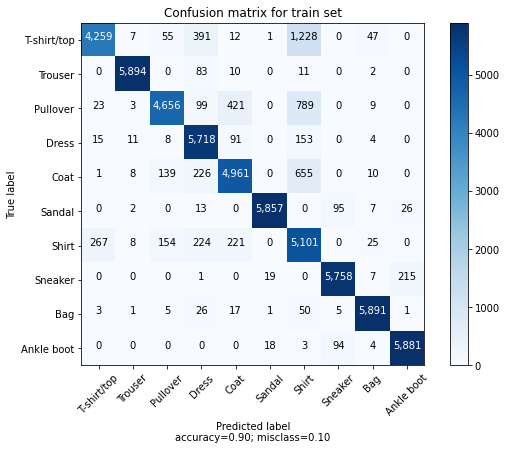

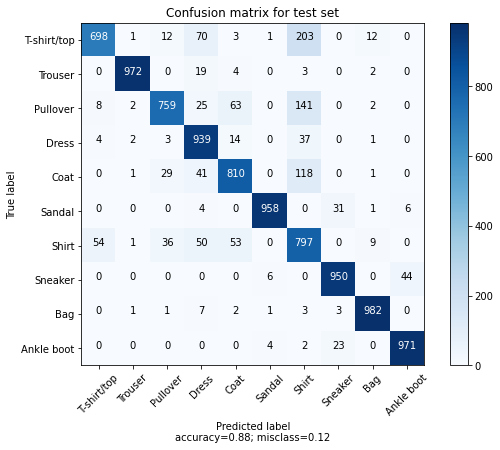

In [ ]:
plot_confusion_matrix(cm_train, class_names, title='Confusion matrix for train set', normalize=False)
print()
plot_confusion_matrix(cm_test, class_names, title='Confusion matrix for test set', normalize=False)

In [ ]:
print('Train set classification report')
print(classification_report(y_true_train, y_pred_train, target_names=class_names))

Train set classification report
              precision    recall  f1-score   support

 T-shirt/top       0.93      0.71      0.81      6000
     Trouser       0.99      0.98      0.99      6000
    Pullover       0.93      0.78      0.85      6000
       Dress       0.84      0.95      0.89      6000
        Coat       0.87      0.83      0.85      6000
      Sandal       0.99      0.98      0.98      6000
       Shirt       0.64      0.85      0.73      6000
     Sneaker       0.97      0.96      0.96      6000
         Bag       0.98      0.98      0.98      6000
  Ankle boot       0.96      0.98      0.97      6000

    accuracy                           0.90     60000
   macro avg       0.91      0.90      0.90     60000
weighted avg       0.91      0.90      0.90     60000



In [ ]:
print('Test set classification report')
print(classification_report(y_true_test, y_pred_test, target_names=class_names))

Test set classification report
              precision    recall  f1-score   support

 T-shirt/top       0.91      0.70      0.79      1000
     Trouser       0.99      0.97      0.98      1000
    Pullover       0.90      0.76      0.82      1000
       Dress       0.81      0.94      0.87      1000
        Coat       0.85      0.81      0.83      1000
      Sandal       0.99      0.96      0.97      1000
       Shirt       0.61      0.80      0.69      1000
     Sneaker       0.94      0.95      0.95      1000
         Bag       0.97      0.98      0.98      1000
  Ankle boot       0.95      0.97      0.96      1000

    accuracy                           0.88     10000
   macro avg       0.89      0.88      0.88     10000
weighted avg       0.89      0.88      0.88     10000



# Dataset prepration (iid or non-iid)

In [12]:

manual_seed(seed)

train_set = torchvision.datasets.FashionMNIST(root="./", download=True, 
                                              train=True,
                                              transform=transforms.Compose([transforms.ToTensor(),transforms.Normalize(0.5,0.5)]))

val_set = torchvision.datasets.FashionMNIST(root="./", download=True, 
                                        train=False,
                                        transform=transforms.Compose([transforms.ToTensor(), transforms.Normalize(0.5,0.5)]))


In [13]:
class CustomTensorDataset(Dataset):
    """TensorDataset with support of transforms."""
    def __init__(self, tensors, transform=None):
        assert all(tensors[0].size(0) == tensor.size(0) for tensor in tensors)
        self.tensors = tensors
        self.transform = transform

    def __getitem__(self, index):
        x = self.tensors[0][index]
        y = self.tensors[1][index]
        if self.transform:
            x = self.transform(x.numpy().astype(np.uint8))
        return x, y

    def __len__(self):
        return self.tensors[0].size(0)
        
def create_datasets(num_clients, iid):
    """Split the whole dataset in IID or non-IID manner for distributing to clients."""
    num_shards = 200
    training_dataset = torchvision.datasets.FashionMNIST(root="./", download=True, 
                                              train=True,
                                              transform=transforms.Compose([transforms.ToTensor(),transforms.Normalize(0.5,0.5)]))


    num_categories = np.unique(training_dataset.targets).shape[0]
    
    if "ndarray" not in str(type(training_dataset.data)):
        training_dataset.data = np.asarray(training_dataset.data)
    if "list" not in str(type(training_dataset.targets)):
        training_dataset.targets = training_dataset.targets.tolist()
    
    # split dataset according to iid flag
    if iid:
        # shuffle data
        shuffled_indices = torch.randperm(len(training_dataset))
        training_inputs = training_dataset.data[shuffled_indices]
        training_labels = torch.Tensor(training_dataset.targets)[shuffled_indices]

        # partition data into num_clients
        split_size = len(training_dataset) // num_clients
        split_datasets = list(
            zip(
                torch.split(torch.Tensor(training_inputs), split_size),
                torch.split(torch.Tensor(training_labels), split_size)
            )
        )

        # finalize bunches of local datasets
        local_datasets = [
            CustomTensorDataset(local_dataset, transform=transforms.Compose([transforms.ToTensor(),transforms.Normalize(0.5,0.5)]))
            for local_dataset in split_datasets
            ]
    else:
        # sort data by labels
        sorted_indices = torch.argsort(torch.Tensor(training_dataset.targets))
        training_inputs = training_dataset.data[sorted_indices]
        training_labels = torch.Tensor(training_dataset.targets)[sorted_indices]

        # partition data into shards first
        shard_size = len(training_dataset) // num_shards #300
        shard_inputs = list(torch.split(torch.Tensor(training_inputs), shard_size))
        shard_labels = list(torch.split(torch.Tensor(training_labels), shard_size))

        # sort the list to conveniently assign samples to each clients from at least two classes
        shard_inputs_sorted, shard_labels_sorted = [], []
        for i in range(num_shards // num_categories):
            for j in range(0, ((num_shards // num_categories) * num_categories), (num_shards // num_categories)):
                shard_inputs_sorted.append(shard_inputs[i + j])
                shard_labels_sorted.append(shard_labels[i + j])
                
        # finalize local datasets by assigning shards to each client
        shards_per_clients = num_shards // num_clients
        local_datasets = [
            CustomTensorDataset(
                (
                    torch.cat(shard_inputs_sorted[i:i + shards_per_clients]),
                    torch.cat(shard_labels_sorted[i:i + shards_per_clients]).long()
                ),
                transform=transforms.Compose([transforms.ToTensor(),transforms.Normalize(0.5,0.5)])
            ) 
            for i in range(0, len(shard_inputs_sorted), shards_per_clients)
        ]
    return local_datasets

# Client

In [27]:
## Patially adopted from https://github.com/vaseline555/Federated-Averaging-PyTorch

class Client(object):
    """
    Class for client object
        id: Integer indicating client's id.
        data: torch.utils.data.Dataset instance containing local data.
        algo: Algorithm: FedAvg, FedProx, or ADMM-based
    """
    def __init__(self, client_config, client_id, local_data, algo, gamma=None, mu=None):
        """Client object is initiated by the center server."""
        self.id = client_id
        self.data = local_data
        self.device = DEVICE
        self.model = None
        self.client_config = client_config
        self.algo = algo
        if algo == "admm":
            self.pi = None
            self.gamma = gamma
            assert self.gamma != None
        elif algo == "fedProx":
            self.mu = mu
            assert self.mu != None
        else:
            self.algo = "fedAvg"

    def __len__(self):
        """Return a total size of the client's local data."""
        return len(self.data)

    def setup(self):
        """Set up common configuration of each client; called by center server."""
        self.model = CNN()
        self.model.to(self.device)
        self.dataloader = DataLoader(self.data, batch_size=client_config["batch_size"], shuffle=True)
        self.local_epoch = self.client_config["num_local_epochs"]
        self.criterion = self.client_config["criterion"]
        self.optimizer = self.client_config["optimizer"]

        if self.algo == "admm":
            self.pi = copy.deepcopy(self.model.state_dict())

    def client_update(self,tot_size=None):
        """Update local model using local dataset."""
        self.model.train()
        self.model.to(self.device)
        if self.algo == "admm":
            old_x = copy.deepcopy(self.model.state_dict())

        if self.algo == "fedProx":
            w_t = copy.deepcopy(self.model.state_dict())
        optimizer = self.optimizer(self.model.parameters(), lr = self.client_config["lr"], momentum = self.client_config["momentum"])
        for e in range(self.local_epoch):
            for data, labels in self.dataloader:
                data, labels = data.float().to(self.device), labels.long().to(self.device)

                optimizer.zero_grad()
                outputs = self.model(data)
                loss = self.criterion()(outputs, labels)

                if self.algo == "fedProx":
                    w_dict = copy.deepcopy(self.model.state_dict())
                    ## Regularization loss
                    reg_loss = 0
                    for l in w_dict.keys():
                        reg_loss += torch.norm(w_dict[l].float() - w_t[l].float(), p = 2)

                    loss = loss + (self.mu/2)*reg_loss

                loss.backward()
                optimizer.step() 
                if self.algo == "admm":
                    new_x = copy.deepcopy(self.model.state_dict())
                    new_pi = copy.deepcopy(self.pi)
                    coef = len(self.data)/tot_size

                    for key in new_x.keys():
                        new_x[key] -= (self.gamma/coef)*self.pi[key]
                        new_pi[key] += coef*(new_x[key]-old_x[key])
                    self.model.load_state_dict(new_x)
                    self.pi = copy.deepcopy(new_pi)

                if self.device == "cuda": torch.cuda.empty_cache()  
                     

        self.model.to("cpu")

    def client_evaluate(self):
        """Evaluate local model using local dataset (same as training set for convenience)."""
        self.model.eval()
        self.model.to(self.device)

        val_loss, correct = 0, 0
        with torch.no_grad():
            for data, labels in self.dataloader:
                data, labels = data.float().to(self.device), labels.long().to(self.device)
                outputs = self.model(data)
                val_loss += self.criterion()(outputs, labels).item()
                
                predicted = outputs.argmax(dim=1, keepdim=True)
                correct += predicted.eq(labels.view_as(predicted)).sum().item()

                if self.device == "cuda": torch.cuda.empty_cache()
        self.model.to("cpu")

        val_loss = val_loss / len(self.dataloader)
        val_accuracy = correct / len(self.data)
        return val_loss, val_accuracy

# Server

In [32]:
## Mostly adopted from https://github.com/vaseline555/Federated-Averaging-PyTorch

class Server(object):
    """Class for implementing center server orchestrating the whole process of federated learning
        clients: List containing Client instances participating a federated learning.
        num_round: number of rounds
        _round: Int for indcating the current federated round.
        model: torch.nn instance for a global model.
        iid: Boolean Indicator of how to split dataset (IID or non-IID).
        fraction: Ratio for the number of clients selected in each federated round.
        num_clients: Total number of participating clients.
        client_config: Client configurations
        algo: Algorithm: FedAvg, FedProx, or ADMM-based

    """
    def __init__(self, num_rounds, num_clients, iid, fraction, client_config, algo, gamma=None, mu=None):
        self.clients = None
        self._round = 0

        self.model = None
        
        self.seed = seed
        self.device = DEVICE

        self.clients = []
        self.iid = iid

        self.fraction = fraction
        self.num_rounds = num_rounds
        self.num_clients = num_clients
        self.client_config = client_config
        self.gamma = gamma
        self.mu = mu
        self.algo = algo
        if algo == "admm":
            self.gamma = gamma
            assert self.gamma != None
        elif algo == "fedProx":
            self.mu = mu
            assert self.mu != None
        else:
            self.algo = "fedAvg"

        self.results = {"train loss": [], "train accuracy": [], "test loss": [], "test accuracy": []}

        
        print(f"Algorithm: {self.algo}")
        print(f"Dataset is iid: {self.iid}")

    def setup(self, **init_kwargs):
        """Set up all configuration for federated learning."""
        # valid only before the very first round
        assert self._round == 0

        # initialize weights of the model
        torch.manual_seed(self.seed)
        
        self.model = CNN()
        local_datasets = create_datasets(num_clients = self.num_clients, iid=self.iid)
        
        for k, dataset in tqdm(enumerate(local_datasets), leave=False):
            client = Client(self.client_config, k, dataset, self.algo, gamma=self.gamma, mu=self.mu)
            client.setup()
            self.clients.append(client)

        self.criterion = self.client_config["criterion"]

        print("Clients generated! Round 0...")
        # prepare train and val sets
        self.val_loader = DataLoader(val_set, batch_size=self.client_config["batch_size"], shuffle=True)
        self.val_data = val_set
        self.train_loader = DataLoader(train_set, batch_size=self.client_config["batch_size"], shuffle=True)
        self.train_data = train_set
        # send the model skeleton to all clients
        self.transmit_model()
        

    def transmit_model(self, sampled_client_indices=None):
        """Send the updated global model to selected/all clients."""
        if sampled_client_indices is None:
            # send the global model to all clients before the very first and after the last federated round
            assert (self._round == 0) or (self._round == self.num_rounds)

            for client in tqdm(self.clients, leave=False):
                client.model = copy.deepcopy(self.model)

            if self._round == self.num_rounds:
                print(f"Federated learning completed after {self.num_rounds} rounds!")

        else:
            # send the global model to selected clients
            assert self._round != 0

            for idx in tqdm(sampled_client_indices, leave=False):
                self.clients[idx].model = copy.deepcopy(self.model)
            
    def sample_clients(self):
        """Select some fraction of all clients."""
        # sample clients randommly
        num_sampled_clients = max(int(self.fraction * self.num_clients), 1)
        sampled_client_indices = sorted(np.random.choice(a=[i for i in range(self.num_clients)], size=num_sampled_clients, replace=False).tolist())
        
        return sampled_client_indices
    
    def update_selected_clients(self, sampled_client_indices):
        """Call "client_update" function of each selected client."""
        # update selected clients

        selected_total_size = 0
        for idx in tqdm(sampled_client_indices, leave=False):
            selected_total_size += len(self.clients[idx])
        for idx in tqdm(sampled_client_indices, leave=False):
            if self.algo != "admm":
                self.clients[idx].client_update()
            else:
                self.clients[idx].client_update(tot_size=selected_total_size)
            

        message = f"[Round: {str(self._round).zfill(4)}] ...{len(sampled_client_indices)} clients are selected and updated (with total sample size: {str(selected_total_size)})!"
        print(message);

        return selected_total_size
    

    def fed_update(self, sampled_client_indices, coefficients):
        """Average the updated and transmitted parameters from each selected client (fedAvg or fedProx)."""
        message = f"[Round: {str(self._round).zfill(4)}] Aggregate updated weights of {len(sampled_client_indices)} clients...!"
        print(message); 

        averaged_weights = OrderedDict()
        for it, idx in tqdm(enumerate(sampled_client_indices), leave=False):
            local_weights = self.clients[idx].model.state_dict()
            if self.algo == "admm":
                local_pi = self.clients[idx].pi
            for key in self.model.state_dict().keys():
                if it == 0:
                    averaged_weights[key] = coefficients[it] * local_weights[key]
                else:
                    averaged_weights[key] += coefficients[it] * local_weights[key]
                if self.algo == "admm":
                    averaged_weights[key] += self.gamma*(local_pi[key].to("cpu"))


        self.model.load_state_dict(averaged_weights)


    def evaluate_selected_models(self, sampled_client_indices):
        """Call "client_evaluate" function of each selected client."""
        for idx in sampled_client_indices:
            self.clients[idx].client_evaluate()


    def train_federated_model(self):
        """Do federated training."""
        # select pre-defined fraction of clients randomly
        sampled_client_indices = self.sample_clients()

        # send global model to the selected clients
        self.transmit_model(sampled_client_indices)

        # updated selected clients with local dataset
        selected_total_size = self.update_selected_clients(sampled_client_indices)

        # evaluate selected clients with local dataset (same as the one used for local update)
        self.evaluate_selected_models(sampled_client_indices)

        # average each updated model parameters of the selected clients and update the global model
        # calculate averaging coefficient of weights
        mixing_coefficients = [len(self.clients[idx]) / selected_total_size for idx in sampled_client_indices]
        self.fed_update(sampled_client_indices, mixing_coefficients)

    def evaluate_global_model(self):
        """Evaluate the global model"""
        self.model.eval()
        self.model.to(self.device)

        train_loss, correct_train = 0, 0
        with torch.no_grad():
            for data, labels in self.train_loader:
                data, labels = data.float().to(self.device), labels.long().to(self.device)
                outputs = self.model(data)
                train_loss += self.criterion()(outputs, labels).item()
                
                predicted = outputs.argmax(dim=1, keepdim=True)
                correct_train += predicted.eq(labels.view_as(predicted)).sum().item()

                if self.device == "cuda": torch.cuda.empty_cache()
        self.model.to("cpu")

        train_loss = train_loss / len(self.train_loader)
        train_accuracy = correct_train / len(self.train_data)

        self.model.eval()
        self.model.to(self.device)
        val_loss, correct_val = 0, 0
        with torch.no_grad():
            for data, labels in self.val_loader:
                data, labels = data.float().to(self.device), labels.long().to(self.device)
                outputs = self.model(data)
                val_loss += self.criterion()(outputs, labels).item()
                
                predicted = outputs.argmax(dim=1, keepdim=True)
                correct_val += predicted.eq(labels.view_as(predicted)).sum().item()

                if self.device == "cuda": torch.cuda.empty_cache()
        self.model.to("cpu")

        val_loss = val_loss / len(self.val_loader)
        val_accuracy = correct_val / len(self.val_data)

        return train_loss, train_accuracy, val_loss, val_accuracy

    def fit(self):
        """Execute the whole process of the federated learning."""
        for r in range(self.num_rounds):
            self._round = r + 1
            
            self.train_federated_model()
            train_loss, train_accuracy, test_loss, test_accuracy = self.evaluate_global_model()
            
            self.results['test loss'].append(test_loss)
            self.results['test accuracy'].append(test_accuracy)
            self.results['train loss'].append(train_loss)
            self.results['train accuracy'].append(train_accuracy)

            message = f"[Round: {str(self._round).zfill(4)}] Evaluate global model's performance...!\
                \n\t[Server] ...finished evaluation!\
                \n\t=> Train Loss: {train_loss:.4f}\
                \n\t=> Train Accuracy: {100. * train_accuracy:.2f}\
                \n\t=> Test Loss: {test_loss:.4f}\
                \n\t=> Test Accuracy: {100. * test_accuracy:.2f}%\n"
            print(message)  
        self.transmit_model()

        return self.results


# FedAvg (iid data)

In [34]:
loc_batch_size = 128
loc_epochs = 10
fraction_clients = 0.1
num_rounds = 80
lr = 0.05
momentum = 0.9
optimizer = torch.optim.SGD
criterion = torch.nn.CrossEntropyLoss
num_clients = 100

client_config = {}
client_config["batch_size"] = loc_batch_size
client_config["num_local_epochs"] = loc_epochs
client_config["criterion"] = criterion
client_config["optimizer"] = optimizer
client_config["lr"] = lr
client_config["momentum"] = momentum
algo = "fedAvg"
iid = True
server =  Server(num_rounds, num_clients, iid, fraction_clients, client_config, algo, gamma=None, mu=None)

server.setup()
history_avg_iid = server.fit()



Algorithm: fedAvg
Dataset is iid: True


0it [00:00, ?it/s]

Clients generated! Round 0...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0001] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0001] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0001] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.8164                
	=> Train Accuracy: 64.08                
	=> Test Loss: 1.8171                
	=> Test Accuracy: 63.94%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0002] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0002] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0002] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7126                
	=> Train Accuracy: 74.96                
	=> Test Loss: 1.7205                
	=> Test Accuracy: 74.36%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0003] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0003] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0003] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6822                
	=> Train Accuracy: 78.07                
	=> Test Loss: 1.6896                
	=> Test Accuracy: 77.47%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0004] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0004] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0004] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6566                
	=> Train Accuracy: 80.73                
	=> Test Loss: 1.6647                
	=> Test Accuracy: 79.73%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0005] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0005] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0005] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6433                
	=> Train Accuracy: 82.06                
	=> Test Loss: 1.6541                
	=> Test Accuracy: 81.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0006] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0006] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0006] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6370                
	=> Train Accuracy: 82.65                
	=> Test Loss: 1.6456                
	=> Test Accuracy: 81.37%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0007] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0007] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0007] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6309                
	=> Train Accuracy: 83.16                
	=> Test Loss: 1.6414                
	=> Test Accuracy: 82.07%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0008] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0008] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0008] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6245                
	=> Train Accuracy: 83.80                
	=> Test Loss: 1.6344                
	=> Test Accuracy: 82.68%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0009] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0009] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0009] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6194                
	=> Train Accuracy: 84.28                
	=> Test Loss: 1.6307                
	=> Test Accuracy: 83.17%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0010] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0010] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0010] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6146                
	=> Train Accuracy: 84.82                
	=> Test Loss: 1.6266                
	=> Test Accuracy: 83.71%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0011] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0011] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0011] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6104                
	=> Train Accuracy: 85.27                
	=> Test Loss: 1.6200                
	=> Test Accuracy: 84.17%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0012] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0012] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0012] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6070                
	=> Train Accuracy: 85.57                
	=> Test Loss: 1.6180                
	=> Test Accuracy: 84.35%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0013] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0013] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0013] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6047                
	=> Train Accuracy: 85.76                
	=> Test Loss: 1.6141                
	=> Test Accuracy: 84.55%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0014] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0014] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0014] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6016                
	=> Train Accuracy: 86.03                
	=> Test Loss: 1.6122                
	=> Test Accuracy: 84.93%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0015] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0015] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0015] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5996                
	=> Train Accuracy: 86.25                
	=> Test Loss: 1.6098                
	=> Test Accuracy: 84.90%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0016] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0016] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0016] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5973                
	=> Train Accuracy: 86.46                
	=> Test Loss: 1.6081                
	=> Test Accuracy: 85.32%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0017] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0017] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0017] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5935                
	=> Train Accuracy: 86.89                
	=> Test Loss: 1.6042                
	=> Test Accuracy: 85.72%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0018] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0018] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0018] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5920                
	=> Train Accuracy: 87.03                
	=> Test Loss: 1.6025                
	=> Test Accuracy: 85.98%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0019] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0019] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0019] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5898                
	=> Train Accuracy: 87.27                
	=> Test Loss: 1.5994                
	=> Test Accuracy: 86.10%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0020] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0020] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0020] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5879                
	=> Train Accuracy: 87.47                
	=> Test Loss: 1.5991                
	=> Test Accuracy: 86.43%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0021] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0021] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0021] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5855                
	=> Train Accuracy: 87.65                
	=> Test Loss: 1.5972                
	=> Test Accuracy: 86.79%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0022] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0022] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0022] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5842                
	=> Train Accuracy: 87.80                
	=> Test Loss: 1.5969                
	=> Test Accuracy: 86.72%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0023] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0023] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0023] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5819                
	=> Train Accuracy: 87.98                
	=> Test Loss: 1.5914                
	=> Test Accuracy: 86.99%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0024] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0024] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0024] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5791                
	=> Train Accuracy: 88.31                
	=> Test Loss: 1.5894                
	=> Test Accuracy: 87.23%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0025] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0025] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0025] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5793                
	=> Train Accuracy: 88.28                
	=> Test Loss: 1.5885                
	=> Test Accuracy: 87.37%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0026] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0026] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0026] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5772                
	=> Train Accuracy: 88.50                
	=> Test Loss: 1.5901                
	=> Test Accuracy: 87.27%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0027] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0027] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0027] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5763                
	=> Train Accuracy: 88.59                
	=> Test Loss: 1.5886                
	=> Test Accuracy: 87.33%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0028] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0028] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0028] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5744                
	=> Train Accuracy: 88.79                
	=> Test Loss: 1.5849                
	=> Test Accuracy: 87.79%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0029] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0029] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0029] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5735                
	=> Train Accuracy: 88.82                
	=> Test Loss: 1.5836                
	=> Test Accuracy: 87.87%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0030] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0030] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0030] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5723                
	=> Train Accuracy: 88.97                
	=> Test Loss: 1.5842                
	=> Test Accuracy: 87.92%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0031] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0031] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0031] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5719                
	=> Train Accuracy: 89.01                
	=> Test Loss: 1.5827                
	=> Test Accuracy: 87.82%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0032] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0032] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0032] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5716                
	=> Train Accuracy: 89.03                
	=> Test Loss: 1.5839                
	=> Test Accuracy: 87.78%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0033] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0033] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0033] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5701                
	=> Train Accuracy: 89.22                
	=> Test Loss: 1.5830                
	=> Test Accuracy: 87.59%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0034] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0034] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0034] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5692                
	=> Train Accuracy: 89.22                
	=> Test Loss: 1.5832                
	=> Test Accuracy: 87.84%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0035] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0035] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0035] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5677                
	=> Train Accuracy: 89.36                
	=> Test Loss: 1.5792                
	=> Test Accuracy: 88.25%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0036] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0036] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0036] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5689                
	=> Train Accuracy: 89.26                
	=> Test Loss: 1.5817                
	=> Test Accuracy: 88.06%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0037] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0037] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0037] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5673                
	=> Train Accuracy: 89.45                
	=> Test Loss: 1.5792                
	=> Test Accuracy: 88.17%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0038] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0038] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0038] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5668                
	=> Train Accuracy: 89.51                
	=> Test Loss: 1.5786                
	=> Test Accuracy: 88.12%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0039] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0039] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0039] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5654                
	=> Train Accuracy: 89.66                
	=> Test Loss: 1.5794                
	=> Test Accuracy: 88.17%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0040] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0040] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0040] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5647                
	=> Train Accuracy: 89.73                
	=> Test Loss: 1.5783                
	=> Test Accuracy: 88.28%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0041] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0041] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0041] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5633                
	=> Train Accuracy: 89.85                
	=> Test Loss: 1.5777                
	=> Test Accuracy: 88.34%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0042] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0042] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0042] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5637                
	=> Train Accuracy: 89.81                
	=> Test Loss: 1.5784                
	=> Test Accuracy: 88.35%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0043] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0043] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0043] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5637                
	=> Train Accuracy: 89.78                
	=> Test Loss: 1.5777                
	=> Test Accuracy: 88.30%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0044] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0044] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0044] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5630                
	=> Train Accuracy: 89.92                
	=> Test Loss: 1.5777                
	=> Test Accuracy: 88.50%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0045] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0045] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0045] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5616                
	=> Train Accuracy: 90.05                
	=> Test Loss: 1.5746                
	=> Test Accuracy: 88.54%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0046] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0046] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0046] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5605                
	=> Train Accuracy: 90.12                
	=> Test Loss: 1.5753                
	=> Test Accuracy: 88.57%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0047] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0047] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0047] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5606                
	=> Train Accuracy: 90.13                
	=> Test Loss: 1.5726                
	=> Test Accuracy: 88.84%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0048] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0048] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0048] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5608                
	=> Train Accuracy: 90.07                
	=> Test Loss: 1.5729                
	=> Test Accuracy: 88.80%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0049] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0049] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0049] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5591                
	=> Train Accuracy: 90.29                
	=> Test Loss: 1.5741                
	=> Test Accuracy: 88.85%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0050] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0050] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0050] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5577                
	=> Train Accuracy: 90.46                
	=> Test Loss: 1.5721                
	=> Test Accuracy: 88.88%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0051] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0051] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0051] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5573                
	=> Train Accuracy: 90.48                
	=> Test Loss: 1.5701                
	=> Test Accuracy: 89.09%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0052] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0052] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0052] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5572                
	=> Train Accuracy: 90.45                
	=> Test Loss: 1.5704                
	=> Test Accuracy: 89.06%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0053] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0053] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0053] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5557                
	=> Train Accuracy: 90.61                
	=> Test Loss: 1.5707                
	=> Test Accuracy: 89.05%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0054] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0054] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0054] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5565                
	=> Train Accuracy: 90.58                
	=> Test Loss: 1.5710                
	=> Test Accuracy: 89.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0055] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0055] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0055] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5552                
	=> Train Accuracy: 90.65                
	=> Test Loss: 1.5700                
	=> Test Accuracy: 89.10%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0056] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0056] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0056] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5543                
	=> Train Accuracy: 90.77                
	=> Test Loss: 1.5690                
	=> Test Accuracy: 89.18%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0057] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0057] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0057] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5548                
	=> Train Accuracy: 90.66                
	=> Test Loss: 1.5682                
	=> Test Accuracy: 89.38%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0058] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0058] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0058] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5541                
	=> Train Accuracy: 90.80                
	=> Test Loss: 1.5680                
	=> Test Accuracy: 89.40%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0059] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0059] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0059] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5531                
	=> Train Accuracy: 90.88                
	=> Test Loss: 1.5678                
	=> Test Accuracy: 89.35%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0060] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0060] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0060] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5532                
	=> Train Accuracy: 90.86                
	=> Test Loss: 1.5680                
	=> Test Accuracy: 89.42%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0061] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0061] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0061] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5535                
	=> Train Accuracy: 90.80                
	=> Test Loss: 1.5691                
	=> Test Accuracy: 89.30%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0062] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0062] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0062] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5518                
	=> Train Accuracy: 91.00                
	=> Test Loss: 1.5669                
	=> Test Accuracy: 89.36%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0063] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0063] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0063] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5523                
	=> Train Accuracy: 90.96                
	=> Test Loss: 1.5680                
	=> Test Accuracy: 89.31%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0064] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0064] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0064] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5513                
	=> Train Accuracy: 91.08                
	=> Test Loss: 1.5683                
	=> Test Accuracy: 89.25%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0065] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0065] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0065] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5524                
	=> Train Accuracy: 90.97                
	=> Test Loss: 1.5689                
	=> Test Accuracy: 89.36%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0066] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0066] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0066] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5514                
	=> Train Accuracy: 91.00                
	=> Test Loss: 1.5678                
	=> Test Accuracy: 89.29%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0067] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0067] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0067] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5496                
	=> Train Accuracy: 91.21                
	=> Test Loss: 1.5667                
	=> Test Accuracy: 89.47%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0068] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0068] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0068] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5507                
	=> Train Accuracy: 91.10                
	=> Test Loss: 1.5685                
	=> Test Accuracy: 89.36%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0069] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0069] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0069] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5502                
	=> Train Accuracy: 91.15                
	=> Test Loss: 1.5653                
	=> Test Accuracy: 89.63%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0070] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0070] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0070] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5489                
	=> Train Accuracy: 91.27                
	=> Test Loss: 1.5663                
	=> Test Accuracy: 89.48%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0071] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0071] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0071] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5492                
	=> Train Accuracy: 91.24                
	=> Test Loss: 1.5668                
	=> Test Accuracy: 89.48%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0072] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0072] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0072] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5487                
	=> Train Accuracy: 91.28                
	=> Test Loss: 1.5655                
	=> Test Accuracy: 89.55%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0073] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0073] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0073] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5474                
	=> Train Accuracy: 91.42                
	=> Test Loss: 1.5650                
	=> Test Accuracy: 89.52%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0074] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0074] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0074] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5472                
	=> Train Accuracy: 91.46                
	=> Test Loss: 1.5654                
	=> Test Accuracy: 89.57%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0075] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0075] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0075] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5470                
	=> Train Accuracy: 91.46                
	=> Test Loss: 1.5655                
	=> Test Accuracy: 89.58%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0076] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0076] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0076] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5480                
	=> Train Accuracy: 91.38                
	=> Test Loss: 1.5678                
	=> Test Accuracy: 89.40%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0077] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0077] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0077] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5466                
	=> Train Accuracy: 91.55                
	=> Test Loss: 1.5647                
	=> Test Accuracy: 89.56%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0078] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0078] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0078] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5453                
	=> Train Accuracy: 91.68                
	=> Test Loss: 1.5627                
	=> Test Accuracy: 89.82%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0079] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0079] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0079] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5450                
	=> Train Accuracy: 91.66                
	=> Test Loss: 1.5641                
	=> Test Accuracy: 89.76%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0080] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0080] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0080] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5446                
	=> Train Accuracy: 91.75                
	=> Test Loss: 1.5656                
	=> Test Accuracy: 89.75%



  0%|          | 0/100 [00:00<?, ?it/s]

Federated learning completed after 80 rounds!


## FedAvg (non-iid data)

In [35]:
loc_batch_size = 128
loc_epochs = 10
fraction_clients = 0.1
num_rounds = 80
lr = 0.05
momentum = 0.9
optimizer = torch.optim.SGD
criterion = torch.nn.CrossEntropyLoss
num_clients = 100

client_config = {}
client_config["batch_size"] = loc_batch_size
client_config["num_local_epochs"] = loc_epochs
client_config["criterion"] = criterion
client_config["optimizer"] = optimizer
client_config["lr"] = lr
client_config["momentum"] = momentum
algo = "fedAvg"
iid = False
server =  Server(num_rounds, num_clients, iid, fraction_clients, client_config, algo, gamma=None, mu=None)

server.setup()
history_avg_noniid = server.fit()



Algorithm: fedAvg
Dataset is iid: False


0it [00:00, ?it/s]

Clients generated! Round 0...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0001] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0001] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0001] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3608                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3612                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0002] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0002] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0002] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.2461                
	=> Train Accuracy: 18.92                
	=> Test Loss: 2.2451                
	=> Test Accuracy: 19.17%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0003] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0003] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0003] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.2182                
	=> Train Accuracy: 24.03                
	=> Test Loss: 2.2188                
	=> Test Accuracy: 24.14%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0004] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0004] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0004] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.2656                
	=> Train Accuracy: 18.99                
	=> Test Loss: 2.2673                
	=> Test Accuracy: 18.93%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0005] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0005] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0005] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.2117                
	=> Train Accuracy: 24.15                
	=> Test Loss: 2.2117                
	=> Test Accuracy: 24.08%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0006] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0006] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0006] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.0803                
	=> Train Accuracy: 36.77                
	=> Test Loss: 2.0772                
	=> Test Accuracy: 36.83%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0007] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0007] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0007] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.2545                
	=> Train Accuracy: 19.93                
	=> Test Loss: 2.2556                
	=> Test Accuracy: 19.91%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0008] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0008] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0008] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.0018                
	=> Train Accuracy: 47.05                
	=> Test Loss: 2.0035                
	=> Test Accuracy: 47.03%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0009] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0009] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0009] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.0864                
	=> Train Accuracy: 34.14                
	=> Test Loss: 2.0863                
	=> Test Accuracy: 33.94%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0010] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0010] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0010] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.1262                
	=> Train Accuracy: 31.40                
	=> Test Loss: 2.1347                
	=> Test Accuracy: 30.53%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0011] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0011] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0011] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.1017                
	=> Train Accuracy: 36.05                
	=> Test Loss: 2.1012                
	=> Test Accuracy: 36.04%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0012] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0012] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0012] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.9489                
	=> Train Accuracy: 51.45                
	=> Test Loss: 1.9585                
	=> Test Accuracy: 50.65%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0013] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0013] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0013] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.9603                
	=> Train Accuracy: 49.29                
	=> Test Loss: 1.9641                
	=> Test Accuracy: 48.83%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0014] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0014] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0014] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.9689                
	=> Train Accuracy: 47.24                
	=> Test Loss: 1.9741                
	=> Test Accuracy: 46.45%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0015] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0015] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0015] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.0082                
	=> Train Accuracy: 45.72                
	=> Test Loss: 2.0037                
	=> Test Accuracy: 46.21%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0016] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0016] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0016] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.0388                
	=> Train Accuracy: 41.55                
	=> Test Loss: 2.0388                
	=> Test Accuracy: 41.70%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0017] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0017] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0017] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.8922                
	=> Train Accuracy: 57.15                
	=> Test Loss: 1.8964                
	=> Test Accuracy: 56.51%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0018] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0018] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0018] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.0065                
	=> Train Accuracy: 44.93                
	=> Test Loss: 2.0111                
	=> Test Accuracy: 44.39%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0019] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0019] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0019] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.9927                
	=> Train Accuracy: 46.68                
	=> Test Loss: 1.9992                
	=> Test Accuracy: 45.85%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0020] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0020] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0020] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.0351                
	=> Train Accuracy: 41.66                
	=> Test Loss: 2.0376                
	=> Test Accuracy: 41.47%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0021] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0021] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0021] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.9606                
	=> Train Accuracy: 50.07                
	=> Test Loss: 1.9704                
	=> Test Accuracy: 49.06%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0022] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0022] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0022] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.9258                
	=> Train Accuracy: 53.19                
	=> Test Loss: 1.9327                
	=> Test Accuracy: 52.52%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0023] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0023] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0023] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.9460                
	=> Train Accuracy: 51.00                
	=> Test Loss: 1.9515                
	=> Test Accuracy: 50.20%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0024] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0024] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0024] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.8921                
	=> Train Accuracy: 56.74                
	=> Test Loss: 1.9020                
	=> Test Accuracy: 55.91%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0025] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0025] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0025] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7735                
	=> Train Accuracy: 68.49                
	=> Test Loss: 1.7791                
	=> Test Accuracy: 67.72%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0026] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0026] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0026] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.9013                
	=> Train Accuracy: 55.94                
	=> Test Loss: 1.9011                
	=> Test Accuracy: 55.61%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0027] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0027] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0027] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.8521                
	=> Train Accuracy: 60.74                
	=> Test Loss: 1.8644                
	=> Test Accuracy: 59.62%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0028] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0028] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0028] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.9296                
	=> Train Accuracy: 52.82                
	=> Test Loss: 1.9322                
	=> Test Accuracy: 52.62%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0029] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0029] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0029] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7592                
	=> Train Accuracy: 70.14                
	=> Test Loss: 1.7674                
	=> Test Accuracy: 69.05%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0030] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0030] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0030] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.9586                
	=> Train Accuracy: 50.10                
	=> Test Loss: 1.9635                
	=> Test Accuracy: 49.41%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0031] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0031] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0031] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7611                
	=> Train Accuracy: 70.06                
	=> Test Loss: 1.7675                
	=> Test Accuracy: 69.69%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0032] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0032] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0032] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7794                
	=> Train Accuracy: 68.04                
	=> Test Loss: 1.7844                
	=> Test Accuracy: 67.50%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0033] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0033] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0033] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.8688                
	=> Train Accuracy: 58.92                
	=> Test Loss: 1.8795                
	=> Test Accuracy: 57.92%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0034] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0034] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0034] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7871                
	=> Train Accuracy: 67.37                
	=> Test Loss: 1.7937                
	=> Test Accuracy: 66.98%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0035] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0035] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0035] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7629                
	=> Train Accuracy: 69.52                
	=> Test Loss: 1.7680                
	=> Test Accuracy: 68.87%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0036] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0036] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0036] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.8037                
	=> Train Accuracy: 65.57                
	=> Test Loss: 1.8092                
	=> Test Accuracy: 65.10%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0037] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0037] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0037] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7741                
	=> Train Accuracy: 68.68                
	=> Test Loss: 1.7778                
	=> Test Accuracy: 68.19%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0038] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0038] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0038] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7329                
	=> Train Accuracy: 72.83                
	=> Test Loss: 1.7428                
	=> Test Accuracy: 72.06%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0039] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0039] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0039] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.8177                
	=> Train Accuracy: 64.16                
	=> Test Loss: 1.8243                
	=> Test Accuracy: 63.49%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0040] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0040] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0040] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.8366                
	=> Train Accuracy: 62.27                
	=> Test Loss: 1.8440                
	=> Test Accuracy: 61.61%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0041] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0041] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0041] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7263                
	=> Train Accuracy: 73.42                
	=> Test Loss: 1.7336                
	=> Test Accuracy: 72.65%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0042] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0042] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0042] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.8111                
	=> Train Accuracy: 64.94                
	=> Test Loss: 1.8173                
	=> Test Accuracy: 64.19%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0043] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0043] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0043] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7695                
	=> Train Accuracy: 69.10                
	=> Test Loss: 1.7784                
	=> Test Accuracy: 68.10%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0044] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0044] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0044] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.8376                
	=> Train Accuracy: 62.07                
	=> Test Loss: 1.8459                
	=> Test Accuracy: 61.12%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0045] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0045] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0045] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.8011                
	=> Train Accuracy: 65.56                
	=> Test Loss: 1.8072                
	=> Test Accuracy: 64.99%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0046] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0046] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0046] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.8720                
	=> Train Accuracy: 58.61                
	=> Test Loss: 1.8782                
	=> Test Accuracy: 57.91%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0047] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0047] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0047] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.0134                
	=> Train Accuracy: 44.56                
	=> Test Loss: 2.0183                
	=> Test Accuracy: 43.96%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0048] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0048] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0048] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.8442                
	=> Train Accuracy: 61.58                
	=> Test Loss: 1.8478                
	=> Test Accuracy: 61.12%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0049] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0049] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0049] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7969                
	=> Train Accuracy: 66.02                
	=> Test Loss: 1.8106                
	=> Test Accuracy: 64.54%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0050] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0050] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0050] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7924                
	=> Train Accuracy: 66.75                
	=> Test Loss: 1.7969                
	=> Test Accuracy: 66.25%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0051] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0051] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0051] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.9759                
	=> Train Accuracy: 48.31                
	=> Test Loss: 1.9840                
	=> Test Accuracy: 47.56%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0052] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0052] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0052] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7352                
	=> Train Accuracy: 72.54                
	=> Test Loss: 1.7415                
	=> Test Accuracy: 71.83%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0053] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0053] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0053] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7286                
	=> Train Accuracy: 73.14                
	=> Test Loss: 1.7343                
	=> Test Accuracy: 72.47%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0054] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0054] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0054] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7909                
	=> Train Accuracy: 67.01                
	=> Test Loss: 1.7959                
	=> Test Accuracy: 66.47%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0055] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0055] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0055] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.9000                
	=> Train Accuracy: 55.62                
	=> Test Loss: 1.9049                
	=> Test Accuracy: 55.50%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0056] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0056] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0056] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.8507                
	=> Train Accuracy: 60.95                
	=> Test Loss: 1.8584                
	=> Test Accuracy: 60.06%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0057] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0057] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0057] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.8482                
	=> Train Accuracy: 61.02                
	=> Test Loss: 1.8553                
	=> Test Accuracy: 60.32%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0058] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0058] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0058] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.8082                
	=> Train Accuracy: 65.21                
	=> Test Loss: 1.8120                
	=> Test Accuracy: 64.93%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0059] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0059] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0059] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.8602                
	=> Train Accuracy: 59.95                
	=> Test Loss: 1.8609                
	=> Test Accuracy: 59.29%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0060] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0060] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0060] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7054                
	=> Train Accuracy: 75.54                
	=> Test Loss: 1.7099                
	=> Test Accuracy: 75.35%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0061] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0061] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0061] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7295                
	=> Train Accuracy: 73.02                
	=> Test Loss: 1.7350                
	=> Test Accuracy: 72.61%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0062] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0062] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0062] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.9572                
	=> Train Accuracy: 49.95                
	=> Test Loss: 1.9613                
	=> Test Accuracy: 49.45%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0063] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0063] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0063] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7309                
	=> Train Accuracy: 73.01                
	=> Test Loss: 1.7447                
	=> Test Accuracy: 71.90%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0064] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0064] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0064] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7565                
	=> Train Accuracy: 70.27                
	=> Test Loss: 1.7627                
	=> Test Accuracy: 69.63%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0065] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0065] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0065] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.9941                
	=> Train Accuracy: 46.47                
	=> Test Loss: 1.9988                
	=> Test Accuracy: 45.68%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0066] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0066] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0066] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6985                
	=> Train Accuracy: 76.27                
	=> Test Loss: 1.7026                
	=> Test Accuracy: 75.94%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0067] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0067] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0067] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7107                
	=> Train Accuracy: 74.97                
	=> Test Loss: 1.7178                
	=> Test Accuracy: 74.41%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0068] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0068] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0068] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6987                
	=> Train Accuracy: 76.23                
	=> Test Loss: 1.7039                
	=> Test Accuracy: 75.73%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0069] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0069] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0069] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7364                
	=> Train Accuracy: 72.44                
	=> Test Loss: 1.7450                
	=> Test Accuracy: 71.62%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0070] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0070] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0070] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6845                
	=> Train Accuracy: 77.52                
	=> Test Loss: 1.6895                
	=> Test Accuracy: 77.03%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0071] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0071] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0071] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.8998                
	=> Train Accuracy: 55.86                
	=> Test Loss: 1.9038                
	=> Test Accuracy: 55.49%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0072] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0072] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0072] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7625                
	=> Train Accuracy: 69.76                
	=> Test Loss: 1.7651                
	=> Test Accuracy: 69.35%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0073] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0073] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0073] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7154                
	=> Train Accuracy: 74.45                
	=> Test Loss: 1.7266                
	=> Test Accuracy: 73.31%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0074] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0074] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0074] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7559                
	=> Train Accuracy: 70.22                
	=> Test Loss: 1.7621                
	=> Test Accuracy: 69.43%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0075] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0075] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0075] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.9301                
	=> Train Accuracy: 53.02                
	=> Test Loss: 1.9370                
	=> Test Accuracy: 52.53%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0076] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0076] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0076] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7475                
	=> Train Accuracy: 71.31                
	=> Test Loss: 1.7521                
	=> Test Accuracy: 70.85%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0077] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0077] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0077] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7319                
	=> Train Accuracy: 72.71                
	=> Test Loss: 1.7457                
	=> Test Accuracy: 71.18%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0078] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0078] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0078] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6933                
	=> Train Accuracy: 76.79                
	=> Test Loss: 1.6963                
	=> Test Accuracy: 76.42%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0079] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0079] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0079] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6737                
	=> Train Accuracy: 78.70                
	=> Test Loss: 1.6806                
	=> Test Accuracy: 77.99%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0080] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0080] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0080] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6667                
	=> Train Accuracy: 79.50                
	=> Test Loss: 1.6763                
	=> Test Accuracy: 78.52%



  0%|          | 0/100 [00:00<?, ?it/s]

Federated learning completed after 80 rounds!


# FedProx (iid data)

In [36]:
loc_batch_size = 128
loc_epochs = 10
fraction_clients = 0.1
num_rounds = 80
lr = 0.05
momentum = 0.9
optimizer = torch.optim.SGD
criterion = torch.nn.CrossEntropyLoss
num_clients = 100

mu = 3

client_config = {}
client_config["batch_size"] = loc_batch_size
client_config["num_local_epochs"] = loc_epochs
client_config["criterion"] = criterion
client_config["optimizer"] = optimizer
client_config["lr"] = lr
client_config["momentum"] = momentum
algo = "fedProx"
iid = True
server =  Server(num_rounds, num_clients, iid, fraction_clients, client_config, algo, gamma=None, mu=mu)

server.setup()
history_prox_iid = server.fit()



Algorithm: fedProx
Dataset is iid: True


0it [00:00, ?it/s]

Clients generated! Round 0...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0001] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0001] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0001] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.8717                
	=> Train Accuracy: 58.21                
	=> Test Loss: 1.8732                
	=> Test Accuracy: 58.02%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0002] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0002] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0002] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7165                
	=> Train Accuracy: 74.94                
	=> Test Loss: 1.7223                
	=> Test Accuracy: 74.53%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0003] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0003] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0003] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6887                
	=> Train Accuracy: 77.27                
	=> Test Loss: 1.6957                
	=> Test Accuracy: 76.74%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0004] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0004] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0004] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6609                
	=> Train Accuracy: 80.31                
	=> Test Loss: 1.6670                
	=> Test Accuracy: 79.48%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0005] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0005] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0005] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6473                
	=> Train Accuracy: 81.65                
	=> Test Loss: 1.6575                
	=> Test Accuracy: 80.62%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0006] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0006] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0006] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6373                
	=> Train Accuracy: 82.58                
	=> Test Loss: 1.6450                
	=> Test Accuracy: 81.62%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0007] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0007] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0007] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6299                
	=> Train Accuracy: 83.29                
	=> Test Loss: 1.6401                
	=> Test Accuracy: 82.25%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0008] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0008] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0008] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6242                
	=> Train Accuracy: 83.89                
	=> Test Loss: 1.6343                
	=> Test Accuracy: 82.76%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0009] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0009] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0009] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6164                
	=> Train Accuracy: 84.70                
	=> Test Loss: 1.6272                
	=> Test Accuracy: 83.63%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0010] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0010] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0010] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6145                
	=> Train Accuracy: 84.81                
	=> Test Loss: 1.6262                
	=> Test Accuracy: 83.93%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0011] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0011] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0011] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6109                
	=> Train Accuracy: 85.23                
	=> Test Loss: 1.6208                
	=> Test Accuracy: 84.17%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0012] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0012] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0012] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6068                
	=> Train Accuracy: 85.55                
	=> Test Loss: 1.6166                
	=> Test Accuracy: 84.65%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0013] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0013] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0013] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6036                
	=> Train Accuracy: 85.89                
	=> Test Loss: 1.6136                
	=> Test Accuracy: 84.73%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0014] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0014] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0014] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6018                
	=> Train Accuracy: 86.05                
	=> Test Loss: 1.6120                
	=> Test Accuracy: 84.97%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0015] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0015] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0015] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5999                
	=> Train Accuracy: 86.22                
	=> Test Loss: 1.6095                
	=> Test Accuracy: 85.14%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0016] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0016] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0016] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5975                
	=> Train Accuracy: 86.47                
	=> Test Loss: 1.6077                
	=> Test Accuracy: 85.28%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0017] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0017] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0017] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5955                
	=> Train Accuracy: 86.67                
	=> Test Loss: 1.6049                
	=> Test Accuracy: 85.69%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0018] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0018] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0018] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5931                
	=> Train Accuracy: 86.88                
	=> Test Loss: 1.6040                
	=> Test Accuracy: 85.85%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0019] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0019] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0019] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5918                
	=> Train Accuracy: 87.02                
	=> Test Loss: 1.6031                
	=> Test Accuracy: 85.75%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0020] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0020] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0020] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5907                
	=> Train Accuracy: 87.12                
	=> Test Loss: 1.6016                
	=> Test Accuracy: 86.02%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0021] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0021] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0021] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5885                
	=> Train Accuracy: 87.41                
	=> Test Loss: 1.6014                
	=> Test Accuracy: 86.33%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0022] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0022] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0022] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5889                
	=> Train Accuracy: 87.27                
	=> Test Loss: 1.6023                
	=> Test Accuracy: 86.36%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0023] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0023] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0023] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5846                
	=> Train Accuracy: 87.73                
	=> Test Loss: 1.5960                
	=> Test Accuracy: 86.45%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0024] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0024] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0024] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5832                
	=> Train Accuracy: 87.88                
	=> Test Loss: 1.5934                
	=> Test Accuracy: 86.80%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0025] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0025] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0025] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5812                
	=> Train Accuracy: 88.09                
	=> Test Loss: 1.5908                
	=> Test Accuracy: 87.05%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0026] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0026] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0026] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5799                
	=> Train Accuracy: 88.21                
	=> Test Loss: 1.5915                
	=> Test Accuracy: 87.13%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0027] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0027] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0027] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5789                
	=> Train Accuracy: 88.35                
	=> Test Loss: 1.5905                
	=> Test Accuracy: 87.09%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0028] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0028] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0028] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5771                
	=> Train Accuracy: 88.49                
	=> Test Loss: 1.5901                
	=> Test Accuracy: 87.04%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0029] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0029] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0029] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5751                
	=> Train Accuracy: 88.71                
	=> Test Loss: 1.5850                
	=> Test Accuracy: 87.59%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0030] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0030] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0030] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5738                
	=> Train Accuracy: 88.82                
	=> Test Loss: 1.5857                
	=> Test Accuracy: 87.63%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0031] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0031] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0031] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5734                
	=> Train Accuracy: 88.86                
	=> Test Loss: 1.5826                
	=> Test Accuracy: 87.86%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0032] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0032] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0032] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5718                
	=> Train Accuracy: 89.02                
	=> Test Loss: 1.5846                
	=> Test Accuracy: 87.78%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0033] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0033] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0033] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5710                
	=> Train Accuracy: 89.10                
	=> Test Loss: 1.5829                
	=> Test Accuracy: 87.69%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0034] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0034] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0034] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5701                
	=> Train Accuracy: 89.20                
	=> Test Loss: 1.5830                
	=> Test Accuracy: 87.96%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0035] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0035] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0035] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5693                
	=> Train Accuracy: 89.21                
	=> Test Loss: 1.5799                
	=> Test Accuracy: 88.11%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0036] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0036] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0036] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5678                
	=> Train Accuracy: 89.42                
	=> Test Loss: 1.5810                
	=> Test Accuracy: 87.95%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0037] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0037] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0037] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5678                
	=> Train Accuracy: 89.45                
	=> Test Loss: 1.5805                
	=> Test Accuracy: 88.07%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0038] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0038] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0038] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5661                
	=> Train Accuracy: 89.61                
	=> Test Loss: 1.5775                
	=> Test Accuracy: 88.23%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0039] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0039] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0039] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5658                
	=> Train Accuracy: 89.64                
	=> Test Loss: 1.5794                
	=> Test Accuracy: 88.19%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0040] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0040] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0040] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5652                
	=> Train Accuracy: 89.71                
	=> Test Loss: 1.5770                
	=> Test Accuracy: 88.31%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0041] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0041] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0041] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5644                
	=> Train Accuracy: 89.75                
	=> Test Loss: 1.5776                
	=> Test Accuracy: 88.29%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0042] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0042] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0042] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5630                
	=> Train Accuracy: 89.90                
	=> Test Loss: 1.5762                
	=> Test Accuracy: 88.51%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0043] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0043] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0043] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5630                
	=> Train Accuracy: 89.89                
	=> Test Loss: 1.5745                
	=> Test Accuracy: 88.62%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0044] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0044] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0044] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5615                
	=> Train Accuracy: 90.04                
	=> Test Loss: 1.5757                
	=> Test Accuracy: 88.73%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0045] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0045] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0045] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5612                
	=> Train Accuracy: 90.08                
	=> Test Loss: 1.5738                
	=> Test Accuracy: 88.82%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0046] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0046] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0046] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5607                
	=> Train Accuracy: 90.13                
	=> Test Loss: 1.5727                
	=> Test Accuracy: 88.76%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0047] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0047] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0047] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5600                
	=> Train Accuracy: 90.19                
	=> Test Loss: 1.5728                
	=> Test Accuracy: 88.74%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0048] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0048] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0048] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5611                
	=> Train Accuracy: 90.04                
	=> Test Loss: 1.5733                
	=> Test Accuracy: 88.81%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0049] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0049] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0049] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5591                
	=> Train Accuracy: 90.29                
	=> Test Loss: 1.5743                
	=> Test Accuracy: 88.88%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0050] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0050] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0050] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5582                
	=> Train Accuracy: 90.38                
	=> Test Loss: 1.5711                
	=> Test Accuracy: 89.02%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0051] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0051] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0051] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5584                
	=> Train Accuracy: 90.31                
	=> Test Loss: 1.5705                
	=> Test Accuracy: 89.02%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0052] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0052] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0052] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5567                
	=> Train Accuracy: 90.53                
	=> Test Loss: 1.5700                
	=> Test Accuracy: 89.07%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0053] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0053] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0053] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5569                
	=> Train Accuracy: 90.48                
	=> Test Loss: 1.5711                
	=> Test Accuracy: 88.93%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0054] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0054] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0054] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5571                
	=> Train Accuracy: 90.48                
	=> Test Loss: 1.5708                
	=> Test Accuracy: 89.03%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0055] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0055] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0055] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5569                
	=> Train Accuracy: 90.45                
	=> Test Loss: 1.5706                
	=> Test Accuracy: 89.09%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0056] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0056] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0056] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5551                
	=> Train Accuracy: 90.67                
	=> Test Loss: 1.5692                
	=> Test Accuracy: 89.07%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0057] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0057] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0057] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5550                
	=> Train Accuracy: 90.69                
	=> Test Loss: 1.5701                
	=> Test Accuracy: 89.13%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0058] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0058] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0058] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5551                
	=> Train Accuracy: 90.68                
	=> Test Loss: 1.5705                
	=> Test Accuracy: 89.10%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0059] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0059] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0059] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5542                
	=> Train Accuracy: 90.76                
	=> Test Loss: 1.5685                
	=> Test Accuracy: 89.37%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0060] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0060] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0060] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5531                
	=> Train Accuracy: 90.89                
	=> Test Loss: 1.5677                
	=> Test Accuracy: 89.48%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0061] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0061] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0061] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5537                
	=> Train Accuracy: 90.80                
	=> Test Loss: 1.5691                
	=> Test Accuracy: 89.34%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0062] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0062] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0062] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5528                
	=> Train Accuracy: 90.94                
	=> Test Loss: 1.5667                
	=> Test Accuracy: 89.46%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0063] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0063] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0063] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5515                
	=> Train Accuracy: 91.06                
	=> Test Loss: 1.5665                
	=> Test Accuracy: 89.53%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0064] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0064] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0064] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5510                
	=> Train Accuracy: 91.09                
	=> Test Loss: 1.5659                
	=> Test Accuracy: 89.50%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0065] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0065] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0065] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5509                
	=> Train Accuracy: 91.09                
	=> Test Loss: 1.5666                
	=> Test Accuracy: 89.51%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0066] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0066] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0066] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5512                
	=> Train Accuracy: 91.07                
	=> Test Loss: 1.5662                
	=> Test Accuracy: 89.44%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0067] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0067] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0067] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5503                
	=> Train Accuracy: 91.16                
	=> Test Loss: 1.5654                
	=> Test Accuracy: 89.57%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0068] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0068] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0068] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5509                
	=> Train Accuracy: 91.13                
	=> Test Loss: 1.5679                
	=> Test Accuracy: 89.38%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0069] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0069] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0069] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5497                
	=> Train Accuracy: 91.23                
	=> Test Loss: 1.5647                
	=> Test Accuracy: 89.66%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0070] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0070] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0070] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5497                
	=> Train Accuracy: 91.19                
	=> Test Loss: 1.5665                
	=> Test Accuracy: 89.65%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0071] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0071] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0071] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5490                
	=> Train Accuracy: 91.31                
	=> Test Loss: 1.5664                
	=> Test Accuracy: 89.49%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0072] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0072] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0072] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5486                
	=> Train Accuracy: 91.37                
	=> Test Loss: 1.5661                
	=> Test Accuracy: 89.48%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0073] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0073] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0073] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5488                
	=> Train Accuracy: 91.30                
	=> Test Loss: 1.5647                
	=> Test Accuracy: 89.61%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0074] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0074] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0074] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5478                
	=> Train Accuracy: 91.39                
	=> Test Loss: 1.5659                
	=> Test Accuracy: 89.56%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0075] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0075] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0075] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5465                
	=> Train Accuracy: 91.55                
	=> Test Loss: 1.5657                
	=> Test Accuracy: 89.57%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0076] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0076] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0076] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5470                
	=> Train Accuracy: 91.48                
	=> Test Loss: 1.5673                
	=> Test Accuracy: 89.45%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0077] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0077] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0077] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5467                
	=> Train Accuracy: 91.44                
	=> Test Loss: 1.5641                
	=> Test Accuracy: 89.56%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0078] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0078] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0078] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5455                
	=> Train Accuracy: 91.67                
	=> Test Loss: 1.5643                
	=> Test Accuracy: 89.65%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0079] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0079] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0079] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5471                
	=> Train Accuracy: 91.49                
	=> Test Loss: 1.5671                
	=> Test Accuracy: 89.46%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0080] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0080] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0080] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.5450                
	=> Train Accuracy: 91.72                
	=> Test Loss: 1.5668                
	=> Test Accuracy: 89.77%



  0%|          | 0/100 [00:00<?, ?it/s]

Federated learning completed after 80 rounds!


# FedProx (non-iid data)

In [37]:
loc_batch_size = 128
loc_epochs = 10
fraction_clients = 0.1
num_rounds = 80
lr = 0.05
momentum = 0.9
optimizer = torch.optim.SGD
criterion = torch.nn.CrossEntropyLoss
num_clients = 100

mu = 3

client_config = {}
client_config["batch_size"] = loc_batch_size
client_config["num_local_epochs"] = loc_epochs
client_config["criterion"] = criterion
client_config["optimizer"] = optimizer
client_config["lr"] = lr
client_config["momentum"] = momentum
algo = "fedProx"
iid = False
server =  Server(num_rounds, num_clients, iid, fraction_clients, client_config, algo, gamma=None, mu=mu)

server.setup()
history_prox_noniid = server.fit()



Algorithm: fedProx
Dataset is iid: False


0it [00:00, ?it/s]

Clients generated! Round 0...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0001] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0001] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0001] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3545                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3549                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0002] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0002] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0002] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3314                
	=> Train Accuracy: 12.33                
	=> Test Loss: 2.3327                
	=> Test Accuracy: 12.24%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0003] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0003] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0003] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3083                
	=> Train Accuracy: 14.99                
	=> Test Loss: 2.3113                
	=> Test Accuracy: 14.66%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0004] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0004] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0004] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3189                
	=> Train Accuracy: 10.15                
	=> Test Loss: 2.3192                
	=> Test Accuracy: 10.15%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0005] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0005] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0005] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.1813                
	=> Train Accuracy: 27.47                
	=> Test Loss: 2.1818                
	=> Test Accuracy: 27.36%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0006] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0006] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0006] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.1944                
	=> Train Accuracy: 26.45                
	=> Test Loss: 2.1971                
	=> Test Accuracy: 26.40%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0007] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0007] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0007] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.0604                
	=> Train Accuracy: 43.42                
	=> Test Loss: 2.0625                
	=> Test Accuracy: 43.18%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0008] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0008] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0008] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.1239                
	=> Train Accuracy: 31.58                
	=> Test Loss: 2.1262                
	=> Test Accuracy: 31.27%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0009] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0009] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0009] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.2242                
	=> Train Accuracy: 23.22                
	=> Test Loss: 2.2246                
	=> Test Accuracy: 22.99%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0010] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0010] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0010] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.1008                
	=> Train Accuracy: 35.03                
	=> Test Loss: 2.1034                
	=> Test Accuracy: 34.98%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0011] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0011] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0011] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.1821                
	=> Train Accuracy: 27.50                
	=> Test Loss: 2.1825                
	=> Test Accuracy: 27.48%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0012] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0012] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0012] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.0141                
	=> Train Accuracy: 44.71                
	=> Test Loss: 2.0199                
	=> Test Accuracy: 43.98%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0013] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0013] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0013] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.9991                
	=> Train Accuracy: 45.76                
	=> Test Loss: 2.0059                
	=> Test Accuracy: 44.98%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0014] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0014] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0014] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.0879                
	=> Train Accuracy: 36.46                
	=> Test Loss: 2.0938                
	=> Test Accuracy: 35.77%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0015] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0015] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0015] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.9103                
	=> Train Accuracy: 55.41                
	=> Test Loss: 1.9106                
	=> Test Accuracy: 55.16%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0016] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0016] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0016] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.0398                
	=> Train Accuracy: 40.84                
	=> Test Loss: 2.0387                
	=> Test Accuracy: 41.04%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0017] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0017] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0017] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.9507                
	=> Train Accuracy: 50.36                
	=> Test Loss: 1.9540                
	=> Test Accuracy: 49.96%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0018] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0018] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0018] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.1377                
	=> Train Accuracy: 32.19                
	=> Test Loss: 2.1388                
	=> Test Accuracy: 31.99%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0019] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0019] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0019] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.0101                
	=> Train Accuracy: 44.91                
	=> Test Loss: 2.0121                
	=> Test Accuracy: 44.67%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0020] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0020] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0020] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.9861                
	=> Train Accuracy: 47.65                
	=> Test Loss: 1.9901                
	=> Test Accuracy: 46.98%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0021] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0021] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0021] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.8816                
	=> Train Accuracy: 58.88                
	=> Test Loss: 1.8860                
	=> Test Accuracy: 58.77%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0022] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0022] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0022] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.9006                
	=> Train Accuracy: 56.14                
	=> Test Loss: 1.9130                
	=> Test Accuracy: 54.98%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0023] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0023] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0023] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.8126                
	=> Train Accuracy: 65.71                
	=> Test Loss: 1.8161                
	=> Test Accuracy: 65.61%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0024] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0024] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0024] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.8558                
	=> Train Accuracy: 60.23                
	=> Test Loss: 1.8608                
	=> Test Accuracy: 59.83%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0025] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0025] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0025] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.9608                
	=> Train Accuracy: 50.12                
	=> Test Loss: 1.9572                
	=> Test Accuracy: 50.48%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0026] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0026] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0026] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.8457                
	=> Train Accuracy: 61.16                
	=> Test Loss: 1.8462                
	=> Test Accuracy: 61.14%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0027] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0027] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0027] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7819                
	=> Train Accuracy: 68.45                
	=> Test Loss: 1.7882                
	=> Test Accuracy: 67.89%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0028] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0028] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0028] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.8154                
	=> Train Accuracy: 64.09                
	=> Test Loss: 1.8212                
	=> Test Accuracy: 63.42%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0029] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0029] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0029] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.9384                
	=> Train Accuracy: 51.81                
	=> Test Loss: 1.9401                
	=> Test Accuracy: 52.10%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0030] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0030] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0030] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.8188                
	=> Train Accuracy: 64.15                
	=> Test Loss: 1.8240                
	=> Test Accuracy: 63.53%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0031] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0031] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0031] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.9519                
	=> Train Accuracy: 50.90                
	=> Test Loss: 1.9540                
	=> Test Accuracy: 50.78%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0032] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0032] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0032] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7851                
	=> Train Accuracy: 67.53                
	=> Test Loss: 1.7897                
	=> Test Accuracy: 67.21%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0033] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0033] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0033] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.8246                
	=> Train Accuracy: 63.23                
	=> Test Loss: 1.8309                
	=> Test Accuracy: 62.39%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0034] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0034] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0034] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7873                
	=> Train Accuracy: 67.48                
	=> Test Loss: 1.7932                
	=> Test Accuracy: 67.23%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0035] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0035] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0035] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7513                
	=> Train Accuracy: 71.14                
	=> Test Loss: 1.7558                
	=> Test Accuracy: 70.47%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0036] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0036] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0036] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7415                
	=> Train Accuracy: 72.07                
	=> Test Loss: 1.7475                
	=> Test Accuracy: 71.44%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0037] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0037] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0037] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.8198                
	=> Train Accuracy: 64.14                
	=> Test Loss: 1.8267                
	=> Test Accuracy: 63.51%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0038] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0038] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0038] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.9001                
	=> Train Accuracy: 55.87                
	=> Test Loss: 1.9059                
	=> Test Accuracy: 55.50%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0039] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0039] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0039] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.8058                
	=> Train Accuracy: 65.92                
	=> Test Loss: 1.8055                
	=> Test Accuracy: 65.85%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0040] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0040] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0040] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7483                
	=> Train Accuracy: 71.48                
	=> Test Loss: 1.7527                
	=> Test Accuracy: 71.16%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0041] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0041] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0041] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7522                
	=> Train Accuracy: 71.21                
	=> Test Loss: 1.7595                
	=> Test Accuracy: 70.18%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0042] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0042] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0042] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.8197                
	=> Train Accuracy: 63.86                
	=> Test Loss: 1.8291                
	=> Test Accuracy: 62.82%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0043] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0043] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0043] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7399                
	=> Train Accuracy: 72.33                
	=> Test Loss: 1.7433                
	=> Test Accuracy: 72.05%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0044] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0044] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0044] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.8556                
	=> Train Accuracy: 59.60                
	=> Test Loss: 1.8613                
	=> Test Accuracy: 58.89%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0045] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0045] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0045] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7776                
	=> Train Accuracy: 68.35                
	=> Test Loss: 1.7913                
	=> Test Accuracy: 67.01%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0046] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0046] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0046] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7449                
	=> Train Accuracy: 72.19                
	=> Test Loss: 1.7493                
	=> Test Accuracy: 71.88%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0047] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0047] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0047] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.0006                
	=> Train Accuracy: 45.92                
	=> Test Loss: 2.0041                
	=> Test Accuracy: 45.44%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0048] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0048] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0048] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7514                
	=> Train Accuracy: 70.92                
	=> Test Loss: 1.7530                
	=> Test Accuracy: 70.69%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0049] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0049] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0049] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.8229                
	=> Train Accuracy: 63.66                
	=> Test Loss: 1.8326                
	=> Test Accuracy: 62.51%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0050] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0050] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0050] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7680                
	=> Train Accuracy: 69.46                
	=> Test Loss: 1.7686                
	=> Test Accuracy: 69.46%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0051] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0051] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0051] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7910                
	=> Train Accuracy: 67.22                
	=> Test Loss: 1.7946                
	=> Test Accuracy: 66.89%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0052] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0052] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0052] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7523                
	=> Train Accuracy: 70.88                
	=> Test Loss: 1.7534                
	=> Test Accuracy: 70.60%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0053] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0053] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0053] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7524                
	=> Train Accuracy: 70.97                
	=> Test Loss: 1.7646                
	=> Test Accuracy: 69.34%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0054] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0054] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0054] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.8675                
	=> Train Accuracy: 59.05                
	=> Test Loss: 1.8696                
	=> Test Accuracy: 58.93%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0055] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0055] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0055] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7251                
	=> Train Accuracy: 73.75                
	=> Test Loss: 1.7336                
	=> Test Accuracy: 72.68%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0056] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0056] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0056] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7165                
	=> Train Accuracy: 74.54                
	=> Test Loss: 1.7264                
	=> Test Accuracy: 73.40%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0057] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0057] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0057] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7288                
	=> Train Accuracy: 73.26                
	=> Test Loss: 1.7377                
	=> Test Accuracy: 72.54%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0058] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0058] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0058] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7916                
	=> Train Accuracy: 66.67                
	=> Test Loss: 1.8022                
	=> Test Accuracy: 65.68%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0059] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0059] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0059] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7471                
	=> Train Accuracy: 71.33                
	=> Test Loss: 1.7516                
	=> Test Accuracy: 70.84%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0060] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0060] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0060] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.9164                
	=> Train Accuracy: 54.09                
	=> Test Loss: 1.9228                
	=> Test Accuracy: 53.71%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0061] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0061] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0061] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7033                
	=> Train Accuracy: 76.12                
	=> Test Loss: 1.7036                
	=> Test Accuracy: 75.67%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0062] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0062] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0062] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7046                
	=> Train Accuracy: 75.64                
	=> Test Loss: 1.7150                
	=> Test Accuracy: 74.70%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0063] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0063] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0063] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.8178                
	=> Train Accuracy: 64.21                
	=> Test Loss: 1.8279                
	=> Test Accuracy: 63.49%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0064] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0064] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0064] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7720                
	=> Train Accuracy: 68.78                
	=> Test Loss: 1.7839                
	=> Test Accuracy: 67.74%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0065] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0065] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0065] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6987                
	=> Train Accuracy: 76.67                
	=> Test Loss: 1.7022                
	=> Test Accuracy: 76.26%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0066] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0066] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0066] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6727                
	=> Train Accuracy: 79.22                
	=> Test Loss: 1.6768                
	=> Test Accuracy: 78.61%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0067] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0067] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0067] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.8080                
	=> Train Accuracy: 65.30                
	=> Test Loss: 1.8168                
	=> Test Accuracy: 64.45%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0068] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0068] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0068] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.8541                
	=> Train Accuracy: 60.30                
	=> Test Loss: 1.8606                
	=> Test Accuracy: 59.48%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0069] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0069] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0069] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.8130                
	=> Train Accuracy: 64.52                
	=> Test Loss: 1.8196                
	=> Test Accuracy: 64.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0070] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0070] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0070] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7082                
	=> Train Accuracy: 75.47                
	=> Test Loss: 1.7111                
	=> Test Accuracy: 74.86%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0071] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0071] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0071] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7330                
	=> Train Accuracy: 72.75                
	=> Test Loss: 1.7449                
	=> Test Accuracy: 71.37%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0072] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0072] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0072] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7860                
	=> Train Accuracy: 67.44                
	=> Test Loss: 1.7893                
	=> Test Accuracy: 67.10%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0073] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0073] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0073] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.8528                
	=> Train Accuracy: 60.52                
	=> Test Loss: 1.8652                
	=> Test Accuracy: 59.26%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0074] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0074] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0074] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.8033                
	=> Train Accuracy: 65.87                
	=> Test Loss: 1.8056                
	=> Test Accuracy: 65.66%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0075] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0075] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0075] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7570                
	=> Train Accuracy: 70.24                
	=> Test Loss: 1.7603                
	=> Test Accuracy: 70.16%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0076] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0076] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0076] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6537                
	=> Train Accuracy: 81.07                
	=> Test Loss: 1.6606                
	=> Test Accuracy: 80.47%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0077] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0077] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0077] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7558                
	=> Train Accuracy: 70.36                
	=> Test Loss: 1.7648                
	=> Test Accuracy: 69.52%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0078] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0078] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0078] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7361                
	=> Train Accuracy: 72.56                
	=> Test Loss: 1.7398                
	=> Test Accuracy: 72.08%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0079] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0079] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0079] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6802                
	=> Train Accuracy: 78.24                
	=> Test Loss: 1.6856                
	=> Test Accuracy: 77.70%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0080] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0080] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0080] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7527                
	=> Train Accuracy: 70.88                
	=> Test Loss: 1.7616                
	=> Test Accuracy: 70.31%



  0%|          | 0/100 [00:00<?, ?it/s]

Federated learning completed after 80 rounds!


# LIADMM FL (iid data)

In [43]:
loc_batch_size = 128
loc_epochs = 10
fraction_clients = 0.1
num_rounds = 80
lr = 0.05
momentum = 0.9
optimizer = torch.optim.SGD
criterion = torch.nn.CrossEntropyLoss
num_clients = 100

gamma = lr

client_config = {}
client_config["batch_size"] = loc_batch_size
client_config["num_local_epochs"] = loc_epochs
client_config["criterion"] = criterion
client_config["optimizer"] = optimizer
client_config["lr"] = lr
client_config["momentum"] = momentum
algo = "admm"
iid = True
server =  Server(num_rounds, num_clients, iid, fraction_clients, client_config, algo, gamma=gamma, mu=None)

server.setup()
history_admm_iid = server.fit()



Algorithm: admm
Dataset is iid: True


0it [00:00, ?it/s]

Clients generated! Round 0...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0001] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0001] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0001] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.2970                
	=> Train Accuracy: 15.92                
	=> Test Loss: 2.2970                
	=> Test Accuracy: 16.08%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0002] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0002] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0002] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.2621                
	=> Train Accuracy: 26.01                
	=> Test Loss: 2.2626                
	=> Test Accuracy: 26.48%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0003] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0003] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0003] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.2803                
	=> Train Accuracy: 12.36                
	=> Test Loss: 2.2803                
	=> Test Accuracy: 12.53%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0004] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0004] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0004] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.1531                
	=> Train Accuracy: 46.67                
	=> Test Loss: 2.1534                
	=> Test Accuracy: 46.89%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0005] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0005] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0005] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.2146                
	=> Train Accuracy: 24.22                
	=> Test Loss: 2.2163                
	=> Test Accuracy: 24.17%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0006] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0006] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0006] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.2221                
	=> Train Accuracy: 22.96                
	=> Test Loss: 2.2231                
	=> Test Accuracy: 22.76%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0007] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0007] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0007] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3067                
	=> Train Accuracy: 13.36                
	=> Test Loss: 2.3079                
	=> Test Accuracy: 13.48%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0008] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0008] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0008] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.1564                
	=> Train Accuracy: 28.04                
	=> Test Loss: 2.1563                
	=> Test Accuracy: 28.08%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0009] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0009] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0009] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.2183                
	=> Train Accuracy: 21.37                
	=> Test Loss: 2.2169                
	=> Test Accuracy: 21.48%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0010] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0010] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0010] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.2360                
	=> Train Accuracy: 20.28                
	=> Test Loss: 2.2363                
	=> Test Accuracy: 20.51%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0011] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0011] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0011] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.0704                
	=> Train Accuracy: 38.01                
	=> Test Loss: 2.0677                
	=> Test Accuracy: 38.24%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0012] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0012] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0012] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.0649                
	=> Train Accuracy: 38.97                
	=> Test Loss: 2.0643                
	=> Test Accuracy: 38.75%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0013] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0013] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0013] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.0192                
	=> Train Accuracy: 42.91                
	=> Test Loss: 2.0200                
	=> Test Accuracy: 42.72%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0014] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0014] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0014] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.0172                
	=> Train Accuracy: 43.85                
	=> Test Loss: 2.0154                
	=> Test Accuracy: 43.86%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0015] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0015] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0015] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.9437                
	=> Train Accuracy: 51.69                
	=> Test Loss: 1.9427                
	=> Test Accuracy: 51.79%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0016] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0016] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0016] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.9206                
	=> Train Accuracy: 54.01                
	=> Test Loss: 1.9229                
	=> Test Accuracy: 53.84%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0017] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0017] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0017] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.9150                
	=> Train Accuracy: 54.61                
	=> Test Loss: 1.9184                
	=> Test Accuracy: 54.26%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0018] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0018] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0018] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.9169                
	=> Train Accuracy: 54.41                
	=> Test Loss: 1.9175                
	=> Test Accuracy: 54.21%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0019] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0019] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0019] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.9064                
	=> Train Accuracy: 55.53                
	=> Test Loss: 1.9088                
	=> Test Accuracy: 55.09%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0020] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0020] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0020] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.9052                
	=> Train Accuracy: 55.40                
	=> Test Loss: 1.9090                
	=> Test Accuracy: 55.02%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0021] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0021] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0021] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.8664                
	=> Train Accuracy: 59.60                
	=> Test Loss: 1.8700                
	=> Test Accuracy: 59.46%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0022] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0022] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0022] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.8433                
	=> Train Accuracy: 61.14                
	=> Test Loss: 1.8486                
	=> Test Accuracy: 60.91%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0023] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0023] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0023] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7689                
	=> Train Accuracy: 70.24                
	=> Test Loss: 1.7727                
	=> Test Accuracy: 69.84%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0024] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0024] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0024] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7361                
	=> Train Accuracy: 73.14                
	=> Test Loss: 1.7385                
	=> Test Accuracy: 72.82%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0025] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0025] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0025] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7200                
	=> Train Accuracy: 74.51                
	=> Test Loss: 1.7198                
	=> Test Accuracy: 74.32%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0026] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0026] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0026] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7131                
	=> Train Accuracy: 75.03                
	=> Test Loss: 1.7137                
	=> Test Accuracy: 75.05%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0027] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0027] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0027] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7157                
	=> Train Accuracy: 74.70                
	=> Test Loss: 1.7200                
	=> Test Accuracy: 74.58%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0028] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0028] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0028] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7072                
	=> Train Accuracy: 75.64                
	=> Test Loss: 1.7130                
	=> Test Accuracy: 75.20%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0029] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0029] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0029] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.7114                
	=> Train Accuracy: 75.17                
	=> Test Loss: 1.7172                
	=> Test Accuracy: 74.85%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0030] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0030] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0030] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6986                
	=> Train Accuracy: 76.41                
	=> Test Loss: 1.7013                
	=> Test Accuracy: 76.22%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0031] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0031] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0031] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6989                
	=> Train Accuracy: 76.37                
	=> Test Loss: 1.7006                
	=> Test Accuracy: 76.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0032] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0032] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0032] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6888                
	=> Train Accuracy: 77.31                
	=> Test Loss: 1.6929                
	=> Test Accuracy: 76.94%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0033] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0033] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0033] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6866                
	=> Train Accuracy: 77.56                
	=> Test Loss: 1.6910                
	=> Test Accuracy: 77.16%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0034] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0034] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0034] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6761                
	=> Train Accuracy: 78.67                
	=> Test Loss: 1.6793                
	=> Test Accuracy: 78.01%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0035] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0035] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0035] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6727                
	=> Train Accuracy: 79.03                
	=> Test Loss: 1.6779                
	=> Test Accuracy: 78.75%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0036] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0036] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0036] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6653                
	=> Train Accuracy: 79.69                
	=> Test Loss: 1.6720                
	=> Test Accuracy: 79.13%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0037] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0037] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0037] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6670                
	=> Train Accuracy: 79.47                
	=> Test Loss: 1.6709                
	=> Test Accuracy: 79.17%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0038] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0038] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0038] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6637                
	=> Train Accuracy: 79.78                
	=> Test Loss: 1.6674                
	=> Test Accuracy: 79.33%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0039] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0039] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0039] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6591                
	=> Train Accuracy: 80.21                
	=> Test Loss: 1.6681                
	=> Test Accuracy: 79.55%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0040] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0040] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0040] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6531                
	=> Train Accuracy: 80.81                
	=> Test Loss: 1.6606                
	=> Test Accuracy: 80.17%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0041] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0041] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0041] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6512                
	=> Train Accuracy: 80.96                
	=> Test Loss: 1.6582                
	=> Test Accuracy: 80.33%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0042] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0042] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0042] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6477                
	=> Train Accuracy: 81.35                
	=> Test Loss: 1.6536                
	=> Test Accuracy: 80.69%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0043] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0043] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0043] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6493                
	=> Train Accuracy: 81.14                
	=> Test Loss: 1.6542                
	=> Test Accuracy: 80.47%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0044] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0044] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0044] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6438                
	=> Train Accuracy: 81.68                
	=> Test Loss: 1.6536                
	=> Test Accuracy: 80.73%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0045] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0045] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0045] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6435                
	=> Train Accuracy: 81.69                
	=> Test Loss: 1.6505                
	=> Test Accuracy: 81.04%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0046] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0046] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0046] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6416                
	=> Train Accuracy: 81.91                
	=> Test Loss: 1.6484                
	=> Test Accuracy: 81.19%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0047] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0047] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0047] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6418                
	=> Train Accuracy: 81.90                
	=> Test Loss: 1.6462                
	=> Test Accuracy: 81.28%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0048] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0048] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0048] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6430                
	=> Train Accuracy: 81.77                
	=> Test Loss: 1.6477                
	=> Test Accuracy: 81.21%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0049] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0049] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0049] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6383                
	=> Train Accuracy: 82.21                
	=> Test Loss: 1.6475                
	=> Test Accuracy: 81.62%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0050] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0050] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0050] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6400                
	=> Train Accuracy: 82.03                
	=> Test Loss: 1.6455                
	=> Test Accuracy: 81.46%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0051] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0051] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0051] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6398                
	=> Train Accuracy: 82.09                
	=> Test Loss: 1.6458                
	=> Test Accuracy: 81.41%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0052] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0052] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0052] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6407                
	=> Train Accuracy: 82.00                
	=> Test Loss: 1.6470                
	=> Test Accuracy: 81.41%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0053] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0053] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0053] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6388                
	=> Train Accuracy: 82.17                
	=> Test Loss: 1.6456                
	=> Test Accuracy: 81.51%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0054] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0054] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0054] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6378                
	=> Train Accuracy: 82.28                
	=> Test Loss: 1.6446                
	=> Test Accuracy: 81.54%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0055] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0055] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0055] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6367                
	=> Train Accuracy: 82.38                
	=> Test Loss: 1.6461                
	=> Test Accuracy: 81.45%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0056] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0056] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0056] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6336                
	=> Train Accuracy: 82.69                
	=> Test Loss: 1.6416                
	=> Test Accuracy: 81.76%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0057] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0057] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0057] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6324                
	=> Train Accuracy: 82.80                
	=> Test Loss: 1.6436                
	=> Test Accuracy: 81.70%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0058] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0058] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0058] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6321                
	=> Train Accuracy: 82.84                
	=> Test Loss: 1.6427                
	=> Test Accuracy: 81.81%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0059] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0059] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0059] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6328                
	=> Train Accuracy: 82.73                
	=> Test Loss: 1.6421                
	=> Test Accuracy: 81.88%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0060] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0060] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0060] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6330                
	=> Train Accuracy: 82.75                
	=> Test Loss: 1.6424                
	=> Test Accuracy: 81.97%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0061] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0061] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0061] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6333                
	=> Train Accuracy: 82.71                
	=> Test Loss: 1.6436                
	=> Test Accuracy: 81.86%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0062] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0062] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0062] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6318                
	=> Train Accuracy: 82.86                
	=> Test Loss: 1.6421                
	=> Test Accuracy: 81.96%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0063] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0063] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0063] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6291                
	=> Train Accuracy: 83.14                
	=> Test Loss: 1.6386                
	=> Test Accuracy: 82.27%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0064] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0064] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0064] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6296                
	=> Train Accuracy: 83.11                
	=> Test Loss: 1.6389                
	=> Test Accuracy: 82.09%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0065] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0065] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0065] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6288                
	=> Train Accuracy: 83.17                
	=> Test Loss: 1.6376                
	=> Test Accuracy: 82.26%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0066] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0066] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0066] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6278                
	=> Train Accuracy: 83.28                
	=> Test Loss: 1.6379                
	=> Test Accuracy: 82.36%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0067] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0067] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0067] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6276                
	=> Train Accuracy: 83.28                
	=> Test Loss: 1.6378                
	=> Test Accuracy: 82.29%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0068] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0068] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0068] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6279                
	=> Train Accuracy: 83.26                
	=> Test Loss: 1.6379                
	=> Test Accuracy: 82.41%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0069] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0069] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0069] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6262                
	=> Train Accuracy: 83.46                
	=> Test Loss: 1.6343                
	=> Test Accuracy: 82.55%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0070] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0070] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0070] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6230                
	=> Train Accuracy: 83.74                
	=> Test Loss: 1.6324                
	=> Test Accuracy: 82.86%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0071] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0071] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0071] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6229                
	=> Train Accuracy: 83.75                
	=> Test Loss: 1.6318                
	=> Test Accuracy: 82.82%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0072] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0072] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0072] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6257                
	=> Train Accuracy: 83.45                
	=> Test Loss: 1.6319                
	=> Test Accuracy: 82.75%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0073] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0073] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0073] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6246                
	=> Train Accuracy: 83.58                
	=> Test Loss: 1.6332                
	=> Test Accuracy: 82.63%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0074] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0074] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0074] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6240                
	=> Train Accuracy: 83.65                
	=> Test Loss: 1.6321                
	=> Test Accuracy: 82.79%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0075] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0075] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0075] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6225                
	=> Train Accuracy: 83.83                
	=> Test Loss: 1.6329                
	=> Test Accuracy: 82.84%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0076] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0076] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0076] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6219                
	=> Train Accuracy: 83.87                
	=> Test Loss: 1.6318                
	=> Test Accuracy: 82.81%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0077] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0077] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0077] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6183                
	=> Train Accuracy: 84.22                
	=> Test Loss: 1.6257                
	=> Test Accuracy: 83.34%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0078] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0078] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0078] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6195                
	=> Train Accuracy: 84.13                
	=> Test Loss: 1.6274                
	=> Test Accuracy: 83.17%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0079] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0079] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0079] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6169                
	=> Train Accuracy: 84.37                
	=> Test Loss: 1.6256                
	=> Test Accuracy: 83.42%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0080] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0080] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0080] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 1.6172                
	=> Train Accuracy: 84.36                
	=> Test Loss: 1.6267                
	=> Test Accuracy: 83.55%



  0%|          | 0/100 [00:00<?, ?it/s]

Federated learning completed after 80 rounds!


# LIADMM FL (non-iid data)

In [47]:
loc_batch_size = 128
loc_epochs = 10
fraction_clients = 0.1
num_rounds = 80
lr = 0.05
momentum = 0.9
optimizer = torch.optim.SGD
criterion = torch.nn.CrossEntropyLoss
num_clients = 100

gamma = lr

client_config = {}
client_config["batch_size"] = loc_batch_size
client_config["num_local_epochs"] = loc_epochs
client_config["criterion"] = criterion
client_config["optimizer"] = optimizer
client_config["lr"] = lr
client_config["momentum"] = momentum
algo = "admm"
iid = False
server =  Server(num_rounds, num_clients, iid, fraction_clients, client_config, algo, gamma=gamma, mu=None)

server.setup()
history_admm_noniid = server.fit()



Algorithm: admm
Dataset is iid: False


0it [00:00, ?it/s]

Clients generated! Round 0...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0001] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0001] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0001] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.2954                
	=> Train Accuracy: 16.96                
	=> Test Loss: 2.2954                
	=> Test Accuracy: 16.92%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0002] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0002] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0002] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3131                
	=> Train Accuracy: 10.08                
	=> Test Loss: 2.3131                
	=> Test Accuracy: 10.08%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0003] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0003] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0003] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3072                
	=> Train Accuracy: 12.16                
	=> Test Loss: 2.3073                
	=> Test Accuracy: 12.10%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0004] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0004] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0004] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3612                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3623                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0005] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0005] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0005] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3611                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3608                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0006] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0006] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0006] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3612                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3609                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0007] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0007] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0007] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3612                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3623                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0008] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0008] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0008] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3612                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3616                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0009] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0009] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0009] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3611                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3616                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0010] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0010] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0010] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3612                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3616                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0011] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0011] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0011] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3612                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3616                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0012] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0012] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0012] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3612                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3602                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0013] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0013] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0013] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3612                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3609                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0014] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0014] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0014] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3299                
	=> Train Accuracy: 12.10                
	=> Test Loss: 2.3273                
	=> Test Accuracy: 12.28%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0015] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0015] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0015] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3612                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3609                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0016] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0016] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0016] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3611                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3616                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0017] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0017] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0017] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3611                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3623                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0018] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0018] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0018] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3612                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3609                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0019] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0019] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0019] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3611                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3609                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0020] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0020] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0020] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3611                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3602                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0021] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0021] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0021] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3611                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3609                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0022] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0022] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0022] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3612                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3623                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0023] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0023] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0023] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3611                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3616                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0024] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0024] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0024] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3612                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3616                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0025] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0025] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0025] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3611                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3609                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0026] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0026] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0026] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3612                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3574                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0027] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0027] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0027] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3612                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3609                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0028] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0028] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0028] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3611                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3609                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0029] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0029] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0029] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3612                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3616                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0030] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0030] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0030] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3612                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3595                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0031] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0031] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0031] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3611                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3609                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0032] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0032] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0032] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3611                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3623                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0033] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0033] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0033] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3611                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3609                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0034] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0034] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0034] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3612                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3616                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0035] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0035] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0035] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3612                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3602                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0036] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0036] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0036] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3612                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3623                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0037] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0037] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0037] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3612                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3616                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0038] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0038] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0038] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3611                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3623                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0039] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0039] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0039] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3612                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3623                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0040] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0040] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0040] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3611                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3623                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0041] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0041] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0041] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3611                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3609                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0042] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0042] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0042] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3611                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3595                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0043] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0043] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0043] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3611                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3609                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0044] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0044] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0044] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3612                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3609                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0045] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0045] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0045] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3612                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3609                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0046] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0046] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0046] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3611                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3616                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0047] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0047] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0047] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3612                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3609                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0048] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0048] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0048] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3611                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3616                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0049] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0049] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0049] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3612                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3595                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0050] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0050] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0050] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3611                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3623                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0051] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0051] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0051] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3612                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3616                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0052] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0052] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0052] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3612                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3616                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0053] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0053] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0053] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3612                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3609                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0054] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0054] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0054] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3611                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3609                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0055] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0055] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0055] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3612                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3623                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0056] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0056] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0056] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3612                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3616                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0057] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0057] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0057] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3611                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3616                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0058] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0058] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0058] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3611                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3595                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0059] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0059] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0059] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3611                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3602                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0060] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0060] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0060] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3611                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3602                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0061] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0061] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0061] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3611                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3616                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0062] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0062] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0062] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3611                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3623                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0063] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0063] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0063] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3612                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3616                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0064] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0064] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0064] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3611                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3616                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0065] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0065] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0065] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3611                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3616                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0066] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0066] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0066] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3612                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3609                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0067] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0067] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0067] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3611                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3623                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0068] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0068] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0068] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3612                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3623                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0069] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0069] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0069] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3612                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3609                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0070] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0070] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0070] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3612                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3616                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0071] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0071] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0071] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3612                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3595                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0072] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0072] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0072] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3611                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3616                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0073] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0073] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0073] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3611                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3609                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0074] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0074] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0074] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3612                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3602                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0075] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0075] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0075] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3612                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3623                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0076] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0076] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0076] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3612                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3616                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0077] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0077] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0077] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3611                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3616                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0078] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0078] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0078] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3611                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3609                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0079] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0079] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0079] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3612                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3616                
	=> Test Accuracy: 10.00%



  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

[Round: 0080] ...10 clients are selected and updated (with total sample size: 6000)!
[Round: 0080] Aggregate updated weights of 10 clients...!


0it [00:00, ?it/s]

[Round: 0080] Evaluate global model's performance...!                
	[Server] ...finished evaluation!                
	=> Train Loss: 2.3612                
	=> Train Accuracy: 10.00                
	=> Test Loss: 2.3609                
	=> Test Accuracy: 10.00%



  0%|          | 0/100 [00:00<?, ?it/s]

Federated learning completed after 80 rounds!


# Post-processing

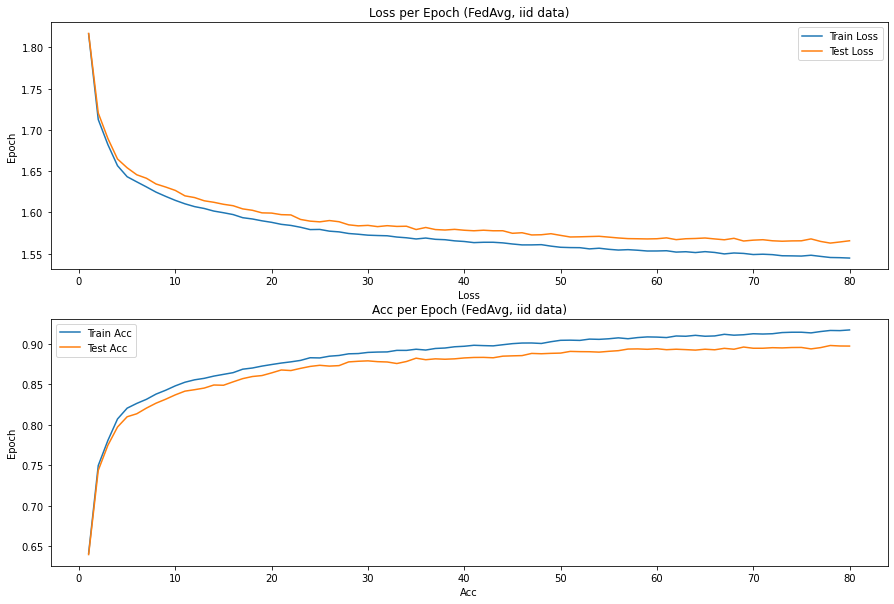

In [39]:
fig, axs = plt.subplots(2, figsize=(15,10))

train_loss = history_avg_iid["train loss"]
val_loss = history_avg_iid["test loss"]
train_acc = history_avg_iid["train accuracy"]
val_acc = history_avg_iid["test accuracy"]
axs[0].plot(list(range(1,len(train_loss)+1)), train_loss, label='Train Loss')
axs[0].plot(list(range(1,len(val_loss)+1)), val_loss, label='Test Loss')
axs[0].set_title('Loss per Epoch (FedAvg, iid data)')
axs[0].set_ylabel('Epoch')
axs[0].set_xlabel('Loss')
axs[0].legend()

axs[1].plot(list(range(1,len(train_acc)+1)), train_acc, label='Train Acc')
axs[1].plot(list(range(1,len(val_acc)+1)), val_acc, label='Test Acc')
axs[1].set_title('Acc per Epoch (FedAvg, iid data)')
axs[1].set_ylabel('Epoch')
axs[1].set_xlabel('Acc')
axs[1].legend()

plt.show()


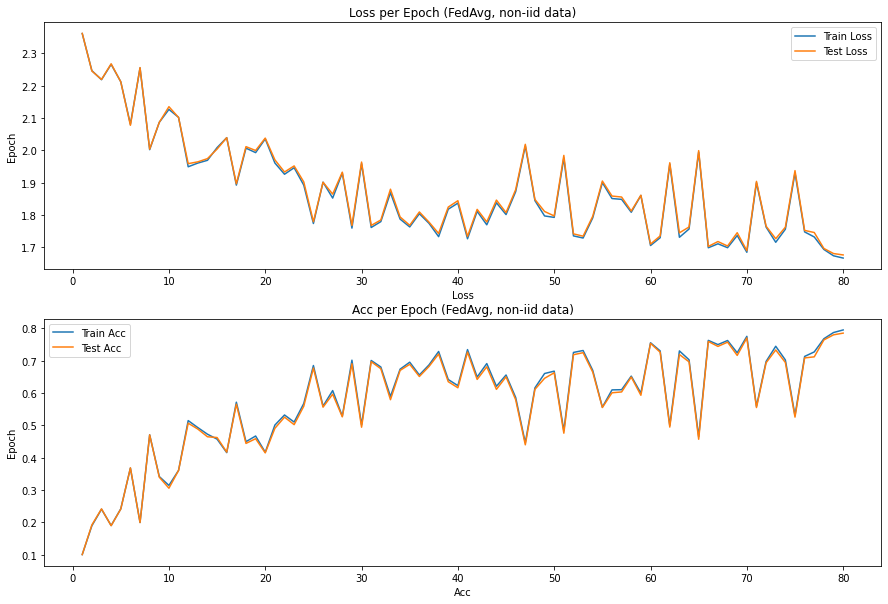

In [40]:
fig, axs = plt.subplots(2, figsize=(15,10))

train_loss = history_avg_noniid["train loss"]
val_loss = history_avg_noniid["test loss"]
train_acc = history_avg_noniid["train accuracy"]
val_acc = history_avg_noniid["test accuracy"]
axs[0].plot(list(range(1,len(train_loss)+1)), train_loss, label='Train Loss')
axs[0].plot(list(range(1,len(val_loss)+1)), val_loss, label='Test Loss')
axs[0].set_title('Loss per Epoch (FedAvg, non-iid data)')
axs[0].set_ylabel('Epoch')
axs[0].set_xlabel('Loss')
axs[0].legend()

axs[1].plot(list(range(1,len(train_acc)+1)), train_acc, label='Train Acc')
axs[1].plot(list(range(1,len(val_acc)+1)), val_acc, label='Test Acc')
axs[1].set_title('Acc per Epoch (FedAvg, non-iid data)')
axs[1].set_ylabel('Epoch')
axs[1].set_xlabel('Acc')
axs[1].legend()

plt.show()


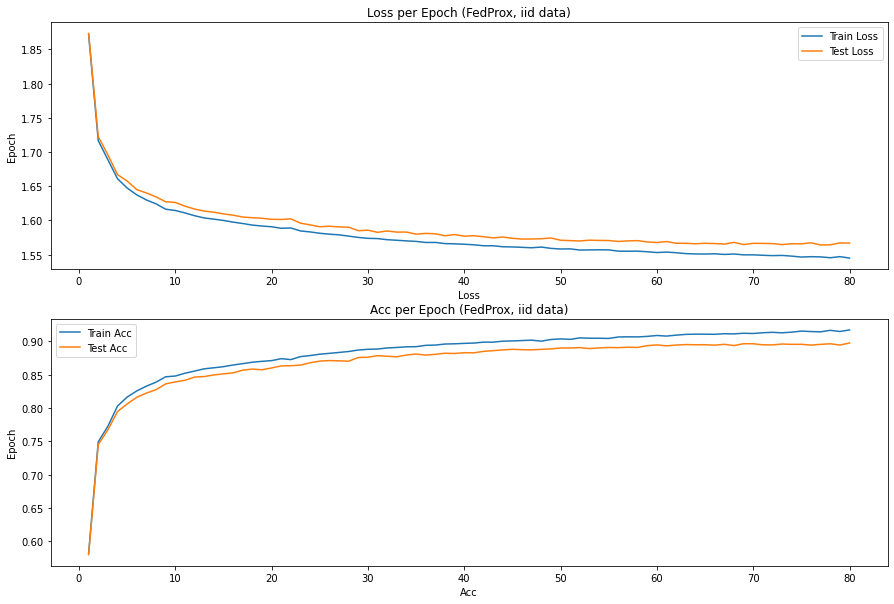

In [41]:
fig, axs = plt.subplots(2, figsize=(15,10))

train_loss = history_prox_iid["train loss"]
val_loss = history_prox_iid["test loss"]
train_acc = history_prox_iid["train accuracy"]
val_acc = history_prox_iid["test accuracy"]
axs[0].plot(list(range(1,len(train_loss)+1)), train_loss, label='Train Loss')
axs[0].plot(list(range(1,len(val_loss)+1)), val_loss, label='Test Loss')
axs[0].set_title('Loss per Epoch (FedProx, iid data)')
axs[0].set_ylabel('Epoch')
axs[0].set_xlabel('Loss')
axs[0].legend()

axs[1].plot(list(range(1,len(train_acc)+1)), train_acc, label='Train Acc')
axs[1].plot(list(range(1,len(val_acc)+1)), val_acc, label='Test Acc')
axs[1].set_title('Acc per Epoch (FedProx, iid data)')
axs[1].set_ylabel('Epoch')
axs[1].set_xlabel('Acc')
axs[1].legend()

plt.show()


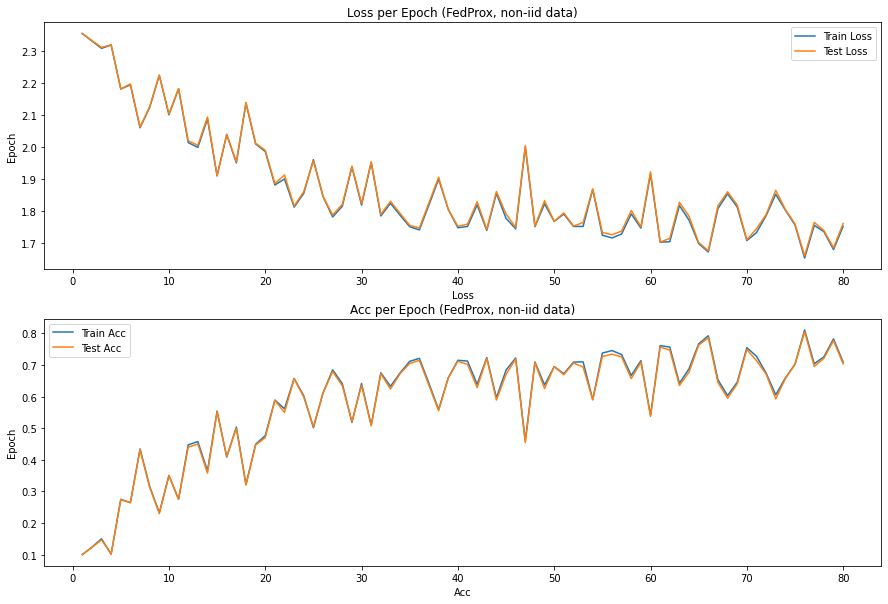

In [42]:
fig, axs = plt.subplots(2, figsize=(15,10))

train_loss = history_prox_noniid["train loss"]
val_loss = history_prox_noniid["test loss"]
train_acc = history_prox_noniid["train accuracy"]
val_acc = history_prox_noniid["test accuracy"]
axs[0].plot(list(range(1,len(train_loss)+1)), train_loss, label='Train Loss')
axs[0].plot(list(range(1,len(val_loss)+1)), val_loss, label='Test Loss')
axs[0].set_title('Loss per Epoch (FedProx, non-iid data)')
axs[0].set_ylabel('Epoch')
axs[0].set_xlabel('Loss')
axs[0].legend()

axs[1].plot(list(range(1,len(train_acc)+1)), train_acc, label='Train Acc')
axs[1].plot(list(range(1,len(val_acc)+1)), val_acc, label='Test Acc')
axs[1].set_title('Acc per Epoch (FedProx, non-iid data)')
axs[1].set_ylabel('Epoch')
axs[1].set_xlabel('Acc')
axs[1].legend()

plt.show()


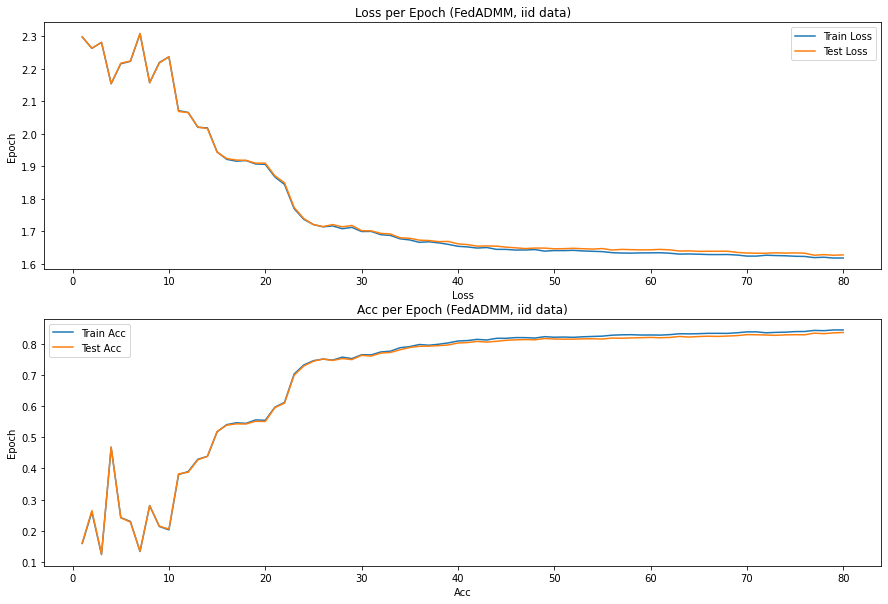

In [45]:
fig, axs = plt.subplots(2, figsize=(15,10))

train_loss = history_admm_iid["train loss"]
val_loss = history_admm_iid["test loss"]
train_acc = history_admm_iid["train accuracy"]
val_acc = history_admm_iid["test accuracy"]
axs[0].plot(list(range(1,len(train_loss)+1)), train_loss, label='Train Loss')
axs[0].plot(list(range(1,len(val_loss)+1)), val_loss, label='Test Loss')
axs[0].set_title('Loss per Epoch (FedADMM, iid data)')
axs[0].set_ylabel('Epoch')
axs[0].set_xlabel('Loss')
axs[0].legend()

axs[1].plot(list(range(1,len(train_acc)+1)), train_acc, label='Train Acc')
axs[1].plot(list(range(1,len(val_acc)+1)), val_acc, label='Test Acc')
axs[1].set_title('Acc per Epoch (FedADMM, iid data)')
axs[1].set_ylabel('Epoch')
axs[1].set_xlabel('Acc')
axs[1].legend()

plt.show()


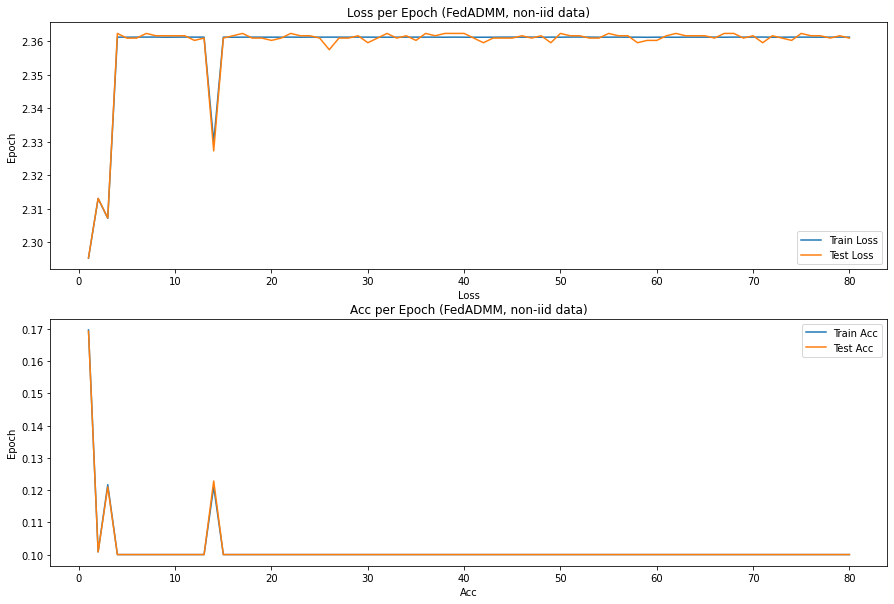

In [48]:
fig, axs = plt.subplots(2, figsize=(15,10))

train_loss = history_admm_noniid["train loss"]
val_loss = history_admm_noniid["test loss"]
train_acc = history_admm_noniid["train accuracy"]
val_acc = history_admm_noniid["test accuracy"]
axs[0].plot(list(range(1,len(train_loss)+1)), train_loss, label='Train Loss')
axs[0].plot(list(range(1,len(val_loss)+1)), val_loss, label='Test Loss')
axs[0].set_title('Loss per Epoch (FedADMM, non-iid data)')
axs[0].set_ylabel('Epoch')
axs[0].set_xlabel('Loss')
axs[0].legend()

axs[1].plot(list(range(1,len(train_acc)+1)), train_acc, label='Train Acc')
axs[1].plot(list(range(1,len(val_acc)+1)), val_acc, label='Test Acc')
axs[1].set_title('Acc per Epoch (FedADMM, non-iid data)')
axs[1].set_ylabel('Epoch')
axs[1].set_xlabel('Acc')
axs[1].legend()

plt.show()
